In [1]:
import os
import subprocess
from IPython.display import FileLink, display

def download_all_in_working(download_file_name="all_files"):
    os.chdir('/kaggle/working/')
    zip_name = f"/kaggle/working/{download_file_name}.zip"
    
    # Use the 'zip' command to zip everything in the current directory
    command = f"zip {zip_name} * -r"  # '*' will include everything in the current working directory
    
    result = subprocess.run(command, shell=True, capture_output=True, text=True)
    
    if result.returncode != 0:
        print("Unable to run zip command!")
        print(result.stderr)
        return
    
    display(FileLink(f'{download_file_name}.zip'))

# Call the function to zip all files and display the download link
download_all_in_working("all_files")

/kaggle/working/all_files.zip

In [2]:
!nvidia-smi

Fri Dec  6 10:40:28 2024       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 560.35.03              Driver Version: 560.35.03      CUDA Version: 12.6     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla P100-PCIE-16GB           Off |   00000000:00:04.0 Off |                    0 |
| N/A   40C    P0             27W /  250W |       0MiB /  16384MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

**NOTE:** To make it easier for us to manage datasets, images and models we create a `HOME` constant.stant.

In [3]:
import os
HOME = os.getcwd()
print(HOME)

/kaggle/working


Install YOLO11 via Ultralytics

In [4]:
%pip install ultralytics supervision roboflow opencv-python pandas
import ultralytics
ultralytics.checks()

Ultralytics 8.3.43 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 6013.4/8062.4 GB disk)


Start Training

In [5]:
from roboflow import Roboflow
rf = Roboflow(api_key="fQ0KboZFwFSsGBuGN4n9")
project = rf.workspace("tes-rmmea").project("klangklingklungbabibu")
version = project.version(7)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to klangklingklungbabibu-7 in yolov11:: 100%|██████████| 6588/6588 [00:00<00:00, 9523.29it/s] 


In [6]:
import time
from ultralytics import YOLO

# Start the timer
start_time = time.time()

# Load a model
model = YOLO("yolo11l.pt")

# Train the model
train_results = model.train(
    data="/kaggle/working/klangklingklungbabibu-7/data.yaml",  # path to dataset YAML
    epochs=100,  # number of training epochs
    imgsz=480,  # training image size
    device=0,  # device to run on, i.e. device=0 or device=0,1,2,3 or device=cpu
)

# Stop the timer
end_time = time.time()

# Compute the elapsed time in seconds
training_time = end_time - start_time

# Print the training time
print(f"Training time: {training_time:.2f} seconds")

100%|██████████| 49.0M/49.0M [00:00<00:00, 131MB/s]


Ultralytics 8.3.43 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=detect, mode=train, model=yolo11l.pt, data=/kaggle/working/klangklingklungbabibu-7/data.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=480, save=True, save_period=-1, cache=False, device=0, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True,

100%|██████████| 755k/755k [00:00<00:00, 17.9MB/s]
2024-12-06 10:40:50,956	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-12-06 10:40:52,082	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


Overriding model.yaml nc=80 with nc=1

                   from  n    params  module                                       arguments                     
  0                  -1  1      1856  ultralytics.nn.modules.conv.Conv             [3, 64, 3, 2]                 
  1                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  2                  -1  2    173824  ultralytics.nn.modules.block.C3k2            [128, 256, 2, True, 0.25]     
  3                  -1  1    590336  ultralytics.nn.modules.conv.Conv             [256, 256, 3, 2]              
  4                  -1  2    691712  ultralytics.nn.modules.block.C3k2            [256, 512, 2, True, 0.25]     
  5                  -1  1   2360320  ultralytics.nn.modules.conv.Conv             [512, 512, 3, 2]              
  6                  -1  2   2234368  ultralytics.nn.modules.block.C3k2            [512, 512, 2, True]           
  7                  -1  1   2360320  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 93.5MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/klangklingklungbabibu-7/train/labels... 3172 images, 0 backgrounds, 0 corrupt: 100%|██████████| 3172/3172 [00:02<00:00, 1211.97it/s]


train: New cache created: /kaggle/working/klangklingklungbabibu-7/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.21 (you have 1.4.17). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
val: Scanning /kaggle/working/klangklingklungbabibu-7/valid/labels... 58 images, 0 backgrounds, 0 corrupt: 100%|██████████| 58/58 [00:00<00:00, 883.61it/s]

val: New cache created: /kaggle/working/klangklingklungbabibu-7/valid/labels.cache


Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 167 weight(decay=0.0), 174 weight(decay=0.0005), 173 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 480 train, 480 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      1/100      6.62G      1.392      1.053      1.442         15        480: 100%|██████████| 199/199 [01:51<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:01<00:00,  1.18it/s]

                   all         58        142     0.0396     0.0352    0.00883    0.00346



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      2/100      6.57G      1.432     0.9569      1.478         17        480: 100%|██████████| 199/199 [01:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  3.00it/s]

                   all         58        142      0.712       0.62      0.561      0.373



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      3/100      6.57G      1.411     0.9157      1.462         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.713      0.704       0.77      0.445



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      4/100      6.61G      1.356     0.8668      1.428         10        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.839       0.77      0.859      0.538



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      5/100      6.55G       1.31     0.8161      1.394         11        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.84it/s]

                   all         58        142      0.889      0.908       0.95      0.661



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      6/100      6.58G      1.269      0.753      1.369         15        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.877      0.901      0.903      0.513



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      7/100      6.55G       1.24     0.7171      1.346         14        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]

                   all         58        142      0.895      0.937      0.966        0.7



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      8/100      6.61G        1.2     0.6914      1.327         13        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.875      0.923      0.932      0.698



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      9/100      6.55G      1.186     0.6737      1.324         12        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.948      0.965      0.984       0.73



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     10/100      6.59G      1.188     0.6651      1.309         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.918      0.941      0.976      0.755



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     11/100      6.55G      1.168      0.642      1.288         13        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.944      0.951      0.978      0.783



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     12/100       6.6G      1.152     0.6339      1.286         14        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]

                   all         58        142      0.928      0.979      0.977      0.782



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     13/100      6.55G      1.124     0.6102      1.269         24        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.956      0.919      0.981      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     14/100       6.6G      1.136     0.6072      1.275         12        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]

                   all         58        142      0.926      0.965      0.981      0.803



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     15/100      6.55G      1.094     0.5914      1.259         10        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.933       0.98      0.986      0.824



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     16/100       6.6G      1.116     0.5826      1.253         12        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all         58        142      0.953      0.986      0.982      0.813



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     17/100      6.54G      1.081     0.5806      1.246          8        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.947      0.998      0.988      0.829



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     18/100       6.6G      1.084     0.5706      1.246         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.948      0.986      0.992      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     19/100      6.55G       1.08     0.5592       1.24         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.986      0.973      0.992      0.814



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     20/100      6.62G      1.063      0.556      1.239         19        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.959      0.981      0.991       0.83



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     21/100      6.55G      1.058     0.5419      1.223         11        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.986      0.985      0.992       0.85



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     22/100      6.59G      1.047      0.541      1.212          9        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.952      0.973      0.986      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     23/100      6.55G      1.046     0.5363      1.216         13        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.973      0.986       0.99      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     24/100       6.6G      1.043      0.534      1.215          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.947      0.998      0.988      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     25/100      6.55G      1.041     0.5366      1.218         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.966          1      0.991      0.827



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     26/100      6.59G      1.056     0.5337       1.22         14        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.943      0.986       0.99      0.843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     27/100      6.55G      1.027      0.514      1.209         11        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142       0.97      0.993      0.992      0.833



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     28/100      6.62G      1.042     0.5215       1.21         19        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.961      0.979      0.991      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     29/100      6.55G       1.02     0.5164      1.197         15        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.972      0.987       0.99      0.815



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     30/100      6.59G      1.031      0.508      1.208         18        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.953      0.992      0.992      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     31/100      6.55G      1.022     0.5129      1.208          7        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.959      0.972      0.985      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     32/100       6.6G          1     0.4996      1.185         15        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.971      0.979      0.991      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     33/100      6.54G       1.01     0.5003      1.193          4        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.974      0.979      0.989      0.835



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     34/100      6.59G      1.005     0.5021      1.195         15        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.971      0.993      0.992      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     35/100      6.56G     0.9984     0.4961       1.19          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.966      0.998       0.99       0.85



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     36/100      6.61G     0.9979     0.4897      1.184          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.979      0.989      0.992      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     37/100      6.53G     0.9801     0.4829      1.175         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.968          1      0.991      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     38/100      6.59G     0.9868     0.4793      1.182          8        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.945          1      0.989      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     39/100      6.54G     0.9757     0.4796       1.18         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.966      0.992      0.988      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     40/100      6.61G      0.972      0.473       1.17         19        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.973      0.999      0.992      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     41/100      6.55G     0.9743     0.4745      1.176          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.978      0.993      0.992      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     42/100      6.59G     0.9831     0.4684      1.171         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.971      0.993      0.991       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     43/100      6.54G     0.9624      0.464      1.164          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.972      0.993      0.988      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     44/100       6.6G     0.9735     0.4668      1.171         12        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.90it/s]

                   all         58        142      0.978          1      0.992      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     45/100      6.54G     0.9532     0.4563      1.164          6        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.973      0.998       0.99      0.868



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     46/100      6.59G     0.9804     0.4664      1.175         24        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.978          1      0.989      0.875



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     47/100      6.56G     0.9339     0.4506      1.149         12        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972      0.993      0.988      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     48/100      6.61G     0.9495     0.4593      1.158         14        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.971          1      0.991      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     49/100      6.55G      0.944     0.4507      1.152         17        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.972      0.993      0.991      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     50/100       6.6G      0.927     0.4443      1.153          7        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.978          1      0.991      0.892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     51/100      6.55G     0.9456      0.447      1.151         20        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.972          1      0.992      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     52/100      6.61G     0.9526     0.4514      1.165         19        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.978          1      0.991      0.888



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     53/100      6.55G     0.9341     0.4434      1.153         19        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979      0.993      0.992      0.893



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     54/100      6.59G      0.937     0.4398      1.138         12        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.972          1       0.99      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     55/100      6.56G     0.9167     0.4341      1.136         12        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.972          1      0.991      0.883



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     56/100      6.61G     0.9282     0.4377      1.141          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         58        142      0.971      0.993      0.992      0.884



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     57/100      6.55G     0.9064     0.4279      1.133         23        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.979          1      0.991      0.894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     58/100       6.6G     0.9054     0.4283      1.135         24        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1       0.99      0.893



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     59/100      6.56G     0.9287     0.4319      1.147         14        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all         58        142      0.978          1      0.991      0.889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     60/100      6.61G     0.9059     0.4269      1.135         13        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979      0.991      0.991      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     61/100      6.54G     0.8971     0.4247      1.137         12        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all         58        142      0.977      0.993      0.991      0.895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     62/100      6.59G     0.9076     0.4229       1.13         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.978      0.993      0.992      0.897



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     63/100      6.55G     0.9073      0.418      1.134         22        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972      0.986      0.991      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     64/100      6.61G     0.9097     0.4193      1.136         13        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972          1      0.991      0.895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     65/100      6.55G     0.8755     0.4084      1.127         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.89it/s]

                   all         58        142      0.978          1       0.99      0.889



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     66/100      6.59G     0.8924     0.4148      1.128         38        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.979      0.993      0.992      0.895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     67/100      6.55G     0.8785     0.4055       1.12         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.88it/s]

                   all         58        142      0.979      0.999      0.992      0.903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     68/100      6.61G     0.8947     0.4163      1.129         19        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.87it/s]

                   all         58        142      0.979          1      0.993      0.903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     69/100      6.54G     0.8941     0.4125      1.129         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         58        142      0.979          1      0.993      0.899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     70/100      6.59G     0.8894     0.4071      1.122         13        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972          1      0.992      0.888



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     71/100      6.55G     0.8904     0.4115      1.124          5        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.978          1      0.993      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     72/100      6.61G     0.8743     0.4009       1.12         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.978      0.993      0.991      0.894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     73/100      6.55G      0.869     0.4029       1.12         10        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.966      0.999      0.992      0.908



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     74/100      6.59G     0.8572     0.3919      1.113          5        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.978          1      0.992      0.903



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     75/100      6.55G     0.8551     0.3917        1.1         14        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.979      0.999      0.992      0.901



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     76/100      6.61G     0.8543     0.3932      1.106         13        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972          1       0.99      0.914



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     77/100      6.55G     0.8621     0.3942      1.104         24        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.978          1      0.991      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     78/100      6.59G     0.8605     0.3924      1.106          9        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.978          1      0.991      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     79/100      6.55G      0.858     0.3919      1.109         15        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.978          1      0.991      0.906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     80/100      6.61G      0.844     0.3846      1.101         27        480: 100%|██████████| 199/199 [01:46<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.979          1      0.991      0.901



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     81/100      6.55G     0.8489     0.3859      1.102          8        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1      0.991      0.899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     82/100      6.58G      0.844     0.3799      1.099         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.979          1       0.99        0.9



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     83/100      6.55G     0.8182     0.3735      1.089         11        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         58        142      0.979          1       0.99      0.904



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     84/100      6.61G     0.8282     0.3772      1.088         19        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1       0.99      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     85/100      6.55G     0.8297     0.3727      1.091         11        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972          1      0.991      0.899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     86/100      6.59G      0.819     0.3743      1.084          7        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979          1      0.991      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     87/100      6.55G     0.8183     0.3707      1.083         11        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979          1      0.992      0.906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     88/100      6.61G     0.8228     0.3711      1.084          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979          1      0.991      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     89/100      6.54G     0.8257     0.3714      1.088          8        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.92it/s]

                   all         58        142      0.972          1      0.991      0.901



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     90/100       6.6G     0.8238     0.3761      1.086         15        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.978          1      0.992      0.901


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     91/100      6.55G     0.7993     0.3142      1.085         11        480: 100%|██████████| 199/199 [01:46<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1      0.992      0.907



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     92/100       6.6G     0.7916     0.3092      1.085         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979          1      0.991      0.906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     93/100      6.54G     0.7861     0.3104      1.075          6        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         58        142      0.979          1      0.991      0.912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     94/100       6.6G     0.7736      0.307      1.063          7        480: 100%|██████████| 199/199 [01:45<00:00,  1.88it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.91it/s]

                   all         58        142      0.979          1      0.991      0.911



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     95/100      6.55G     0.7701     0.3064      1.065          9        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1      0.991      0.909



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     96/100      6.61G     0.7685     0.3024      1.069         10        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         58        142      0.978          1       0.99      0.902



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     97/100      6.55G     0.7645     0.3018       1.06         14        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1      0.991       0.91



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     98/100      6.59G     0.7687     0.2995      1.065          8        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.95it/s]

                   all         58        142      0.979      0.999      0.991       0.91



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


     99/100      6.55G     0.7647     0.3008      1.059          4        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.93it/s]

                   all         58        142      0.979      0.999      0.991      0.913



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


    100/100      6.61G     0.7569     0.2988      1.057          8        480: 100%|██████████| 199/199 [01:45<00:00,  1.89it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.94it/s]

                   all         58        142      0.979          1      0.991      0.915



100 epochs completed in 3.012 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 51.2MB
Optimizer stripped from runs/detect/train/weights/best.pt, 51.2MB

Validating runs/detect/train/weights/best.pt...
Ultralytics 8.3.43 🚀 Python-3.10.14 torch-2.4.0 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLO11l summary (fused): 464 layers, 25,280,083 parameters, 0 gradients, 86.6 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 2/2 [00:00<00:00,  2.42it/s]


                   all         58        142      0.979          1      0.991      0.915
Speed: 0.1ms preprocess, 9.5ms inference, 0.0ms loss, 0.9ms postprocess per image
Results saved to runs/detect/train
Training time: 10881.66 seconds


## Testing

In [7]:
%pip install gdown
import gdown

# Folder ID from the provided link
folder_url = "https://drive.google.com/drive/folders/1-twTlkoIp6xnSwJQpOkQOt7Ksd_BanJG"
# Download the folder using gdown
gdown.download_folder(folder_url, quiet=False)

os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.


Note: you may need to restart the kernel to use updated packages.


Retrieving folder contents


Processing file 1hdnWIr1Dh43-qZS-mz3pxtgTbx8j_59u OTV1.mp4
Processing file 16ChcaZpBDNFYitiRCAkkSQ7SYeUdaqJk OTV2.mp4
Processing file 11cQm3A0jzLmNM81dysbuH_XPFtDiCiV0 OTV3.mp4
Processing file 1Moch0mcJO5ew1Cjt413qrXdgDpnfJrl6 OTV4.mp4
Processing file 171irDEbqVrUd7aXVR8wg1d_FA2RFd6d- OTV5.mp4


Retrieving folder contents completed
Building directory structure
Building directory structure completed
Downloading...
From: https://drive.google.com/uc?id=1hdnWIr1Dh43-qZS-mz3pxtgTbx8j_59u
To: /kaggle/working/Test video (open)/OTV1.mp4
100%|██████████| 59.8M/59.8M [00:00<00:00, 178MB/s]
Downloading...
From: https://drive.google.com/uc?id=16ChcaZpBDNFYitiRCAkkSQ7SYeUdaqJk
To: /kaggle/working/Test video (open)/OTV2.mp4
100%|██████████| 35.5M/35.5M [00:00<00:00, 220MB/s]
Downloading...
From: https://drive.google.com/uc?id=11cQm3A0jzLmNM81dysbuH_XPFtDiCiV0
To: /kaggle/working/Test video (open)/OTV3.mp4
100%|██████████| 63.2M/63.2M [00:00<00:00, 240MB/s]
Downloading...
From: https://drive.google.com/uc?id=1Moch0mcJO5ew1Cjt413qrXdgDpnfJrl6
To: /kaggle/working/Test video (open)/OTV4.mp4
100%|██████████| 79.6M/79.6M [00:00<00:00, 219MB/s]
Downloading...
From: https://drive.google.com/uc?id=171irDEbqVrUd7aXVR8wg1d_FA2RFd6d-
To: /kaggle/working/Test video (open)/OTV5.mp4
100%|██████████| 75.0M

['/kaggle/working/Test video (open)/OTV1.mp4',
 '/kaggle/working/Test video (open)/OTV2.mp4',
 '/kaggle/working/Test video (open)/OTV3.mp4',
 '/kaggle/working/Test video (open)/OTV4.mp4',
 '/kaggle/working/Test video (open)/OTV5.mp4']


0: 480x480 4 marios, 18.1ms
Speed: 1.6ms preprocess, 18.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 480)


Mean of empty slice.
invalid value encountered in scalar divide


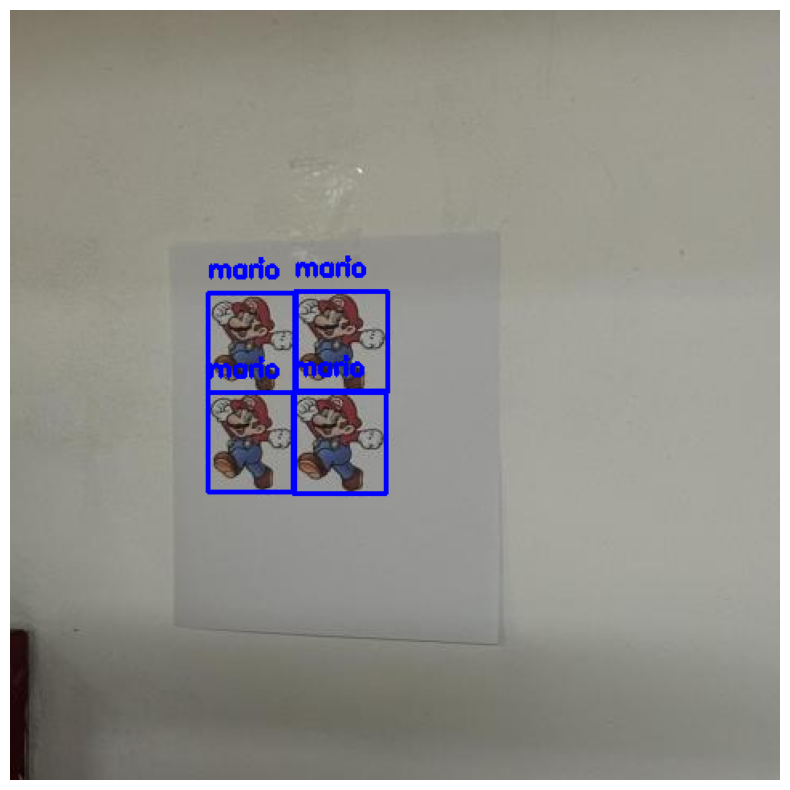

Processed image IMG_1697_jpg.rf.a5f3739cfcf4b210d8be04b4e2b4d226.jpg in 0.7745 seconds

0: 480x480 1 mario, 18.9ms
Speed: 1.5ms preprocess, 18.9ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


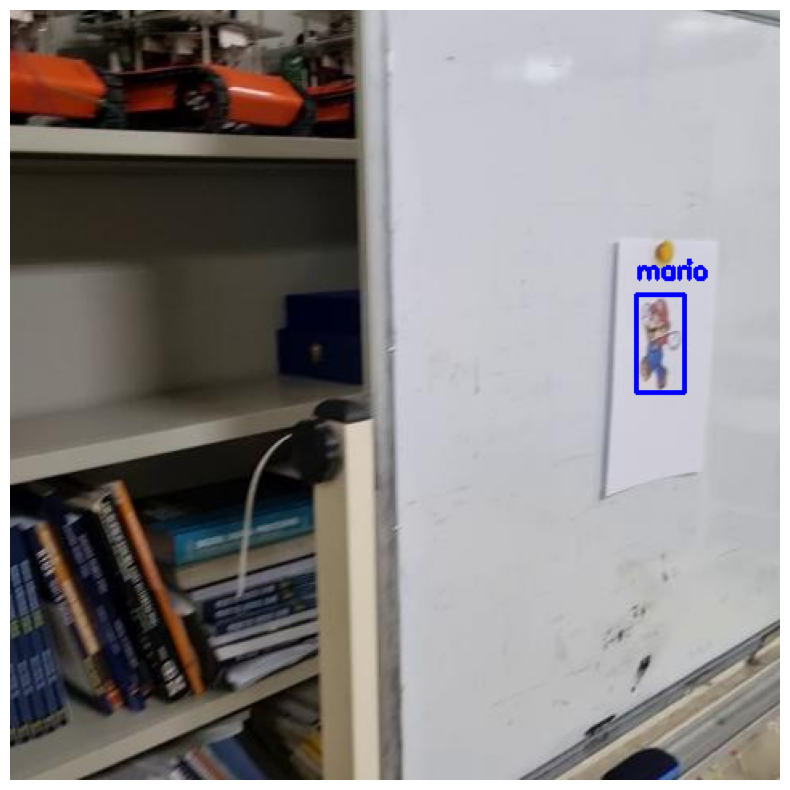

Processed image OTV5-mp4_frame_840_jpg.rf.a52d52f4120ae960db443574d69bc124.jpg in 0.3825 seconds

0: 480x480 3 marios, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


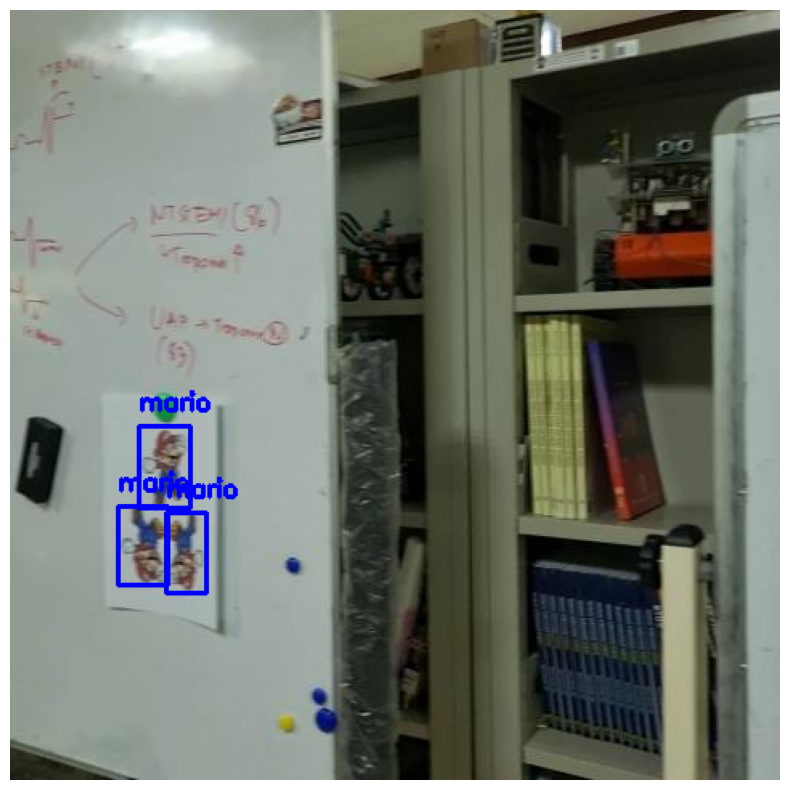

Processed image OTV4-mp4_frame_870_jpg.rf.98c9db04b93f5d1b2587d2213e61f96d.jpg in 0.3988 seconds

0: 480x480 11 marios, 19.2ms
Speed: 1.5ms preprocess, 19.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


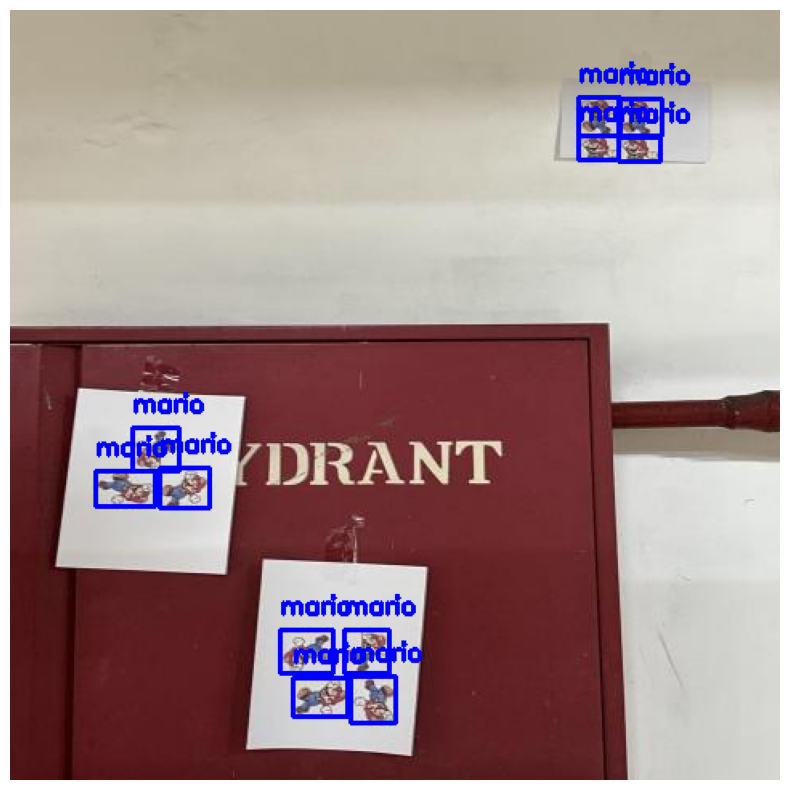

Processed image IMG_1757_jpg.rf.846940e43a459eaa385b6d6fe7309e9d.jpg in 0.3648 seconds

0: 480x480 1 mario, 19.6ms
Speed: 1.9ms preprocess, 19.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


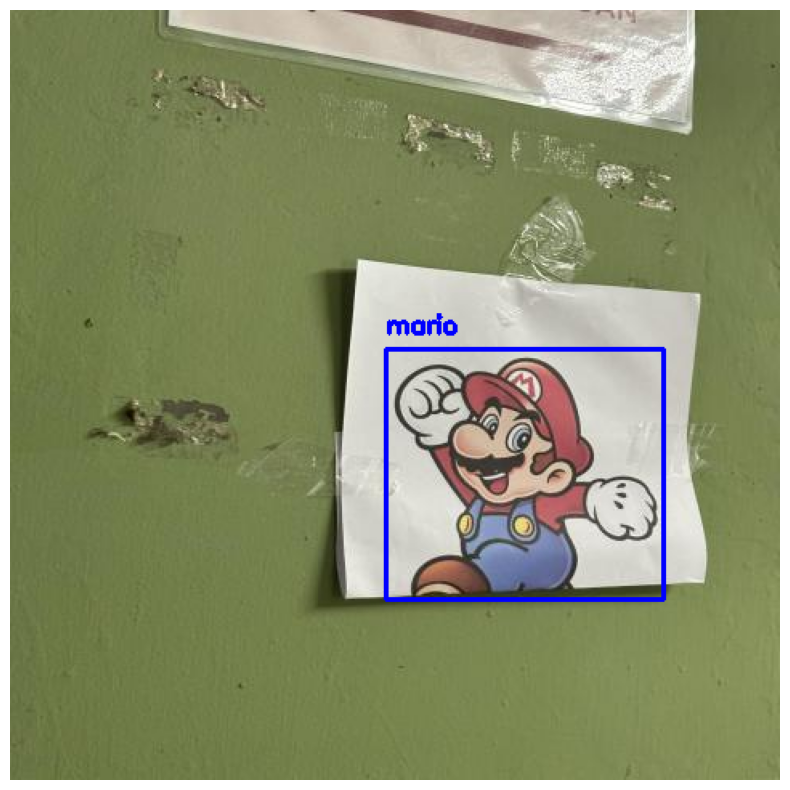

Processed image IMG_1723_jpg.rf.fb91a8eddcd2e64e43e636ca1d5c54ba.jpg in 0.4002 seconds

0: 480x480 1 mario, 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


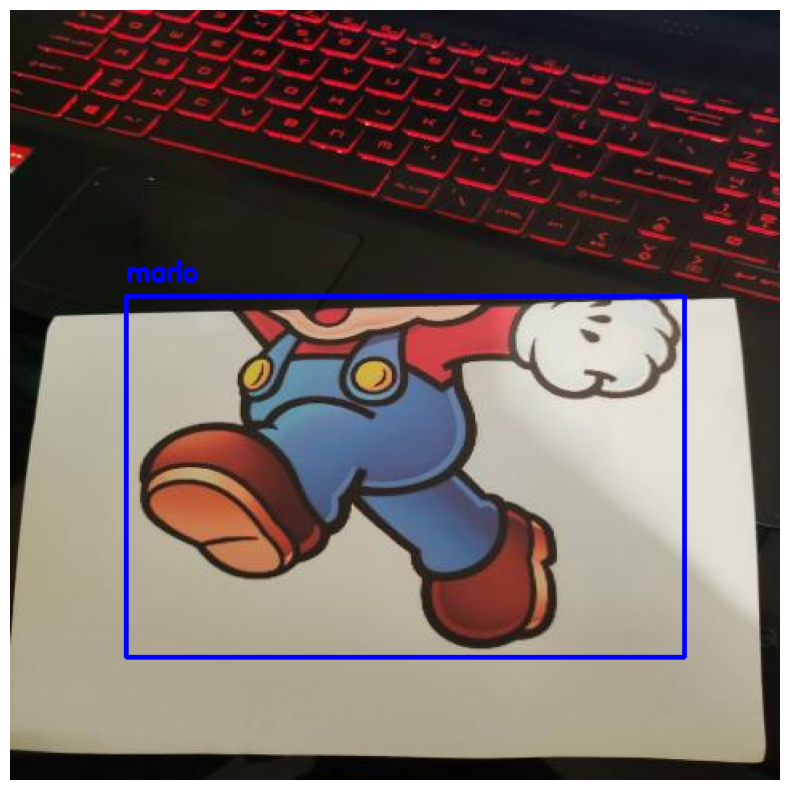

Processed image 580317_jpg.rf.3096590ce7f85cdd36b19684e1c85ada.jpg in 0.4269 seconds

0: 480x480 3 marios, 19.9ms
Speed: 1.6ms preprocess, 19.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


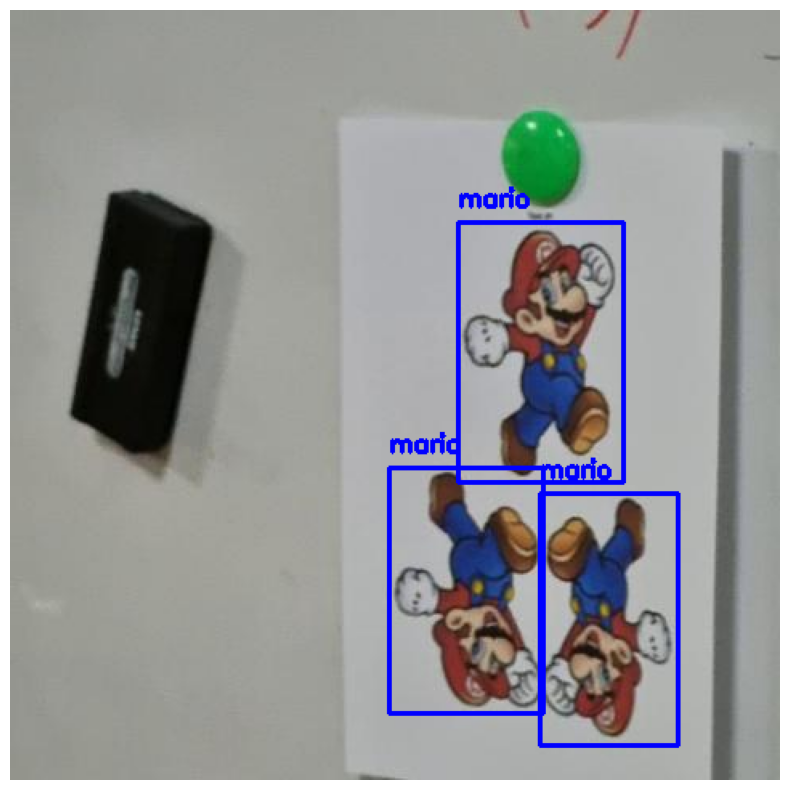

Processed image OTV4-mp4_frame_570_jpg.rf.acecba5d8b69bde8edfca0d32a406c92.jpg in 0.3337 seconds

0: 480x480 1 mario, 18.8ms
Speed: 1.5ms preprocess, 18.8ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


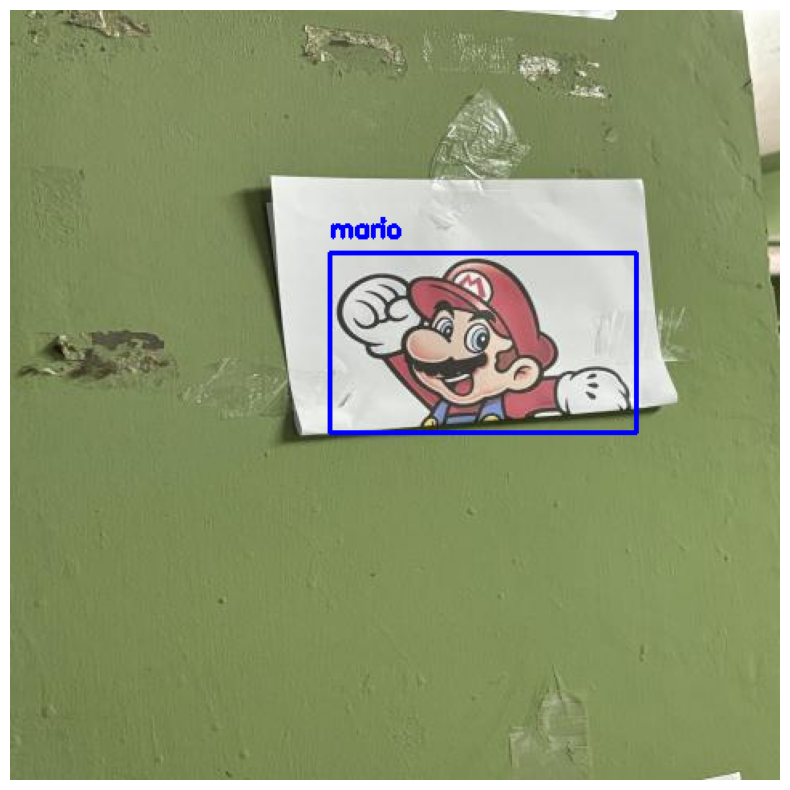

Processed image IMG_1735_jpg.rf.1e6dedf043c4ce4f96ae3f743ba4f1e0.jpg in 0.3832 seconds

0: 480x480 4 marios, 18.1ms
Speed: 1.4ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


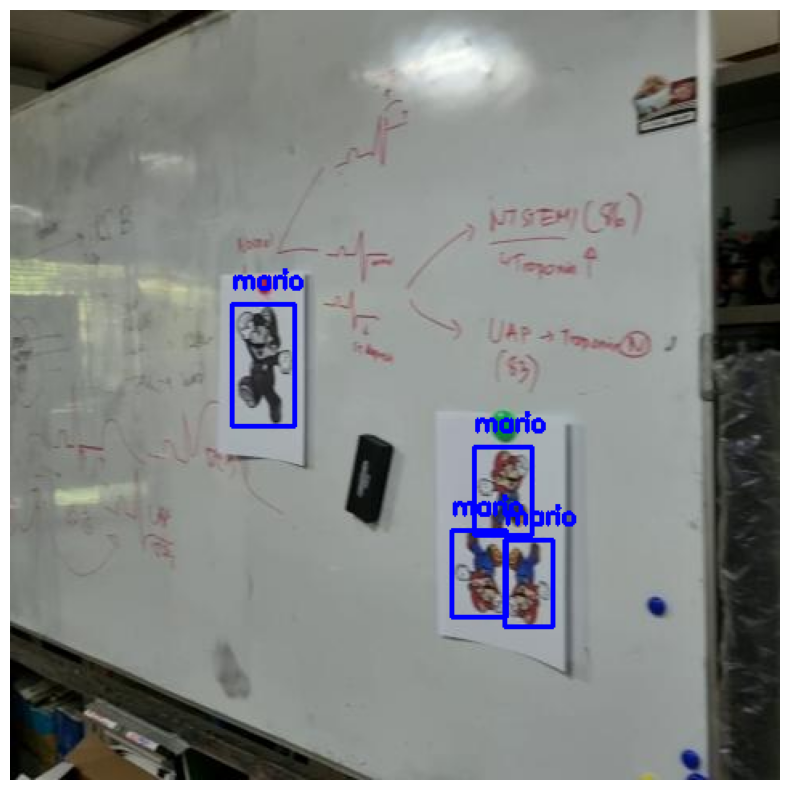

Processed image OTV4-mp4_frame_840_jpg.rf.9163d4313066fca5b9a4d73479a5e90b.jpg in 0.3810 seconds

0: 480x480 3 marios, 18.0ms
Speed: 1.1ms preprocess, 18.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


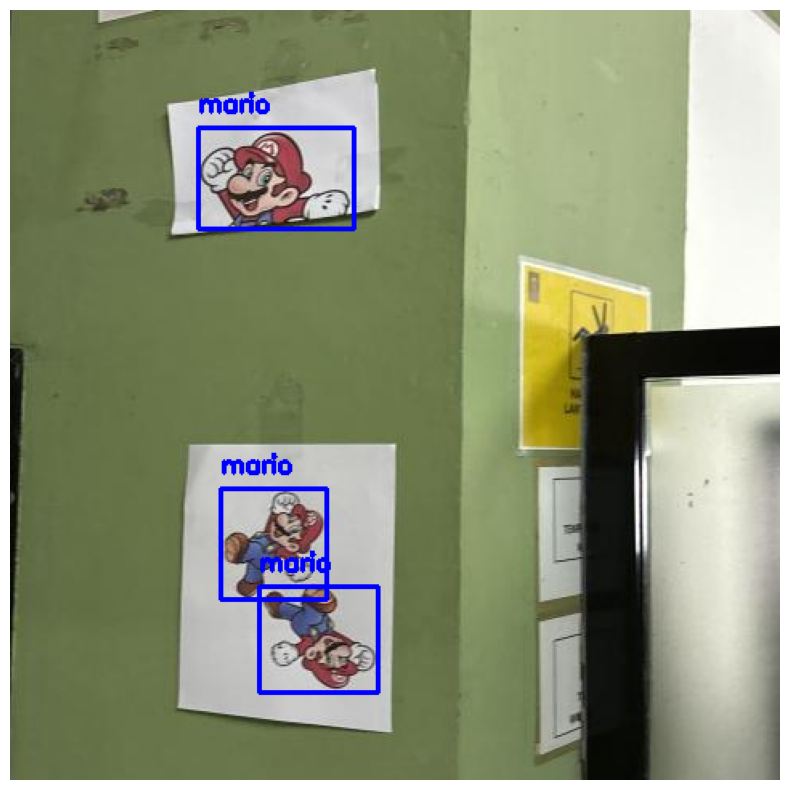

Processed image IMG_1742_jpg.rf.016e15e7124e273c1bd19d6e5ce5e8c4.jpg in 0.3518 seconds

0: 480x480 3 marios, 19.1ms
Speed: 1.5ms preprocess, 19.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


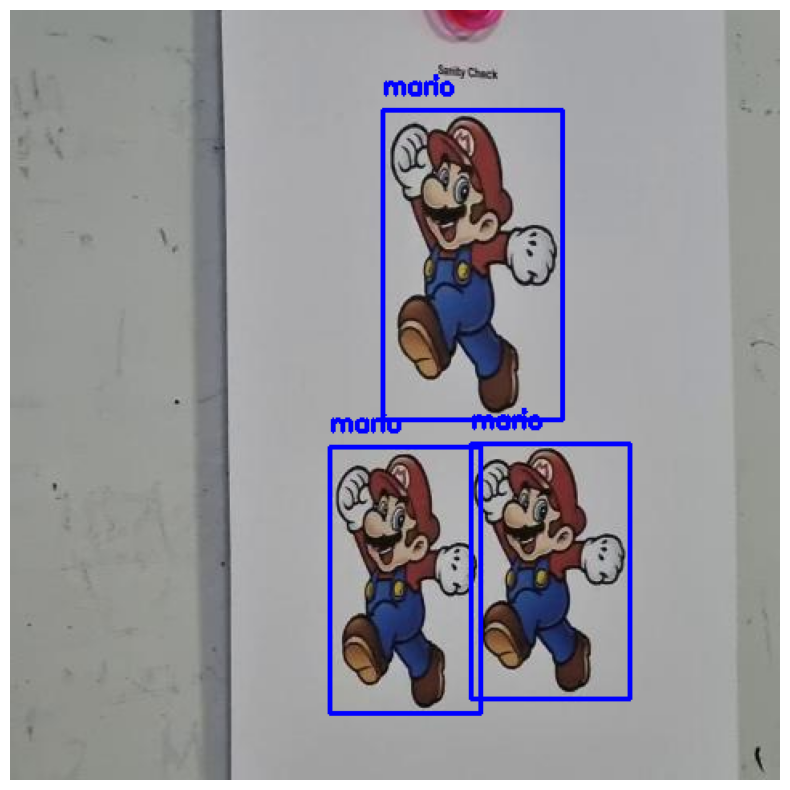

Processed image OTV1-mp4_frame_300_jpg.rf.e7d088f5441d700cff759dcd3b4dfbf4.jpg in 0.3169 seconds

0: 480x480 2 marios, 18.1ms
Speed: 1.6ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


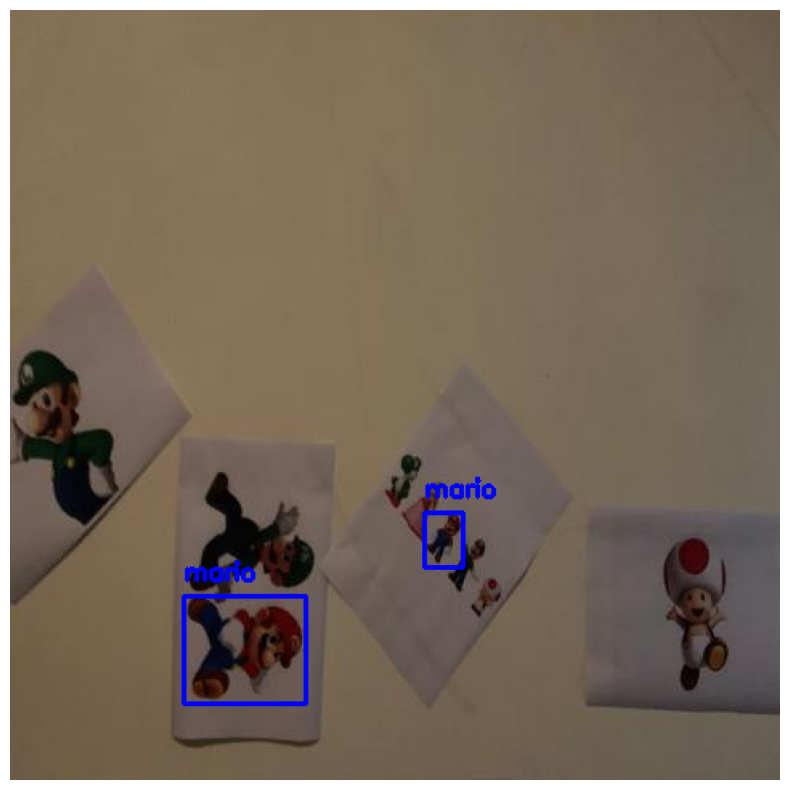

Processed image IMG-20241203-WA0052_jpg.rf.e468d4d9250546ca3e5f34d58dffff41.jpg in 0.3157 seconds

0: 480x480 3 marios, 19.6ms
Speed: 1.3ms preprocess, 19.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


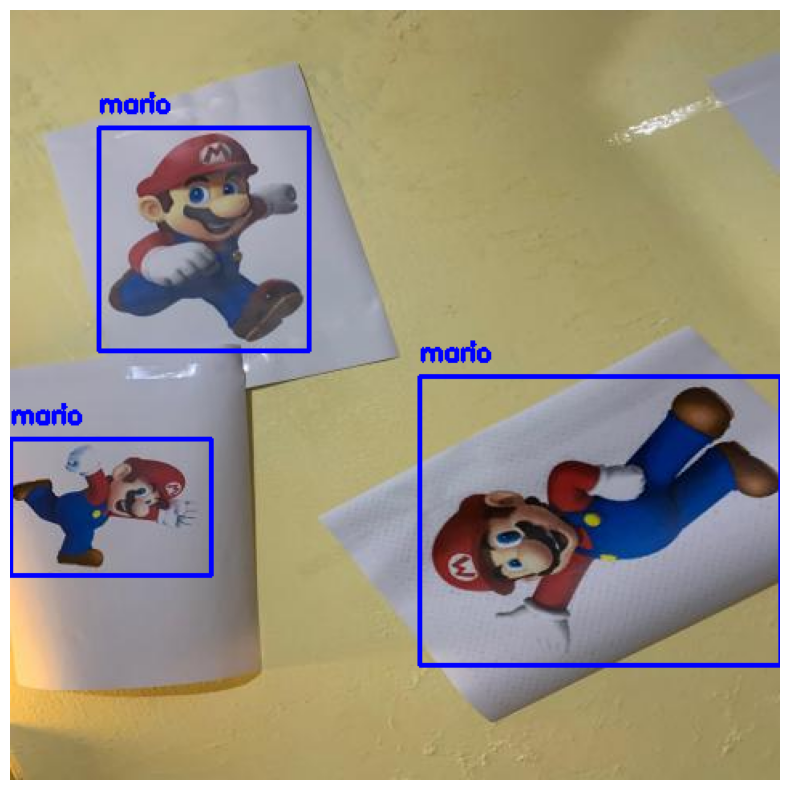

Processed image d48c1256-e306-459a-a181-1dae9cf2e163-1-_jpg.rf.875871b1ab3ce8fc14247de544380265.jpg in 0.4278 seconds

0: 480x480 4 marios, 18.1ms
Speed: 1.9ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


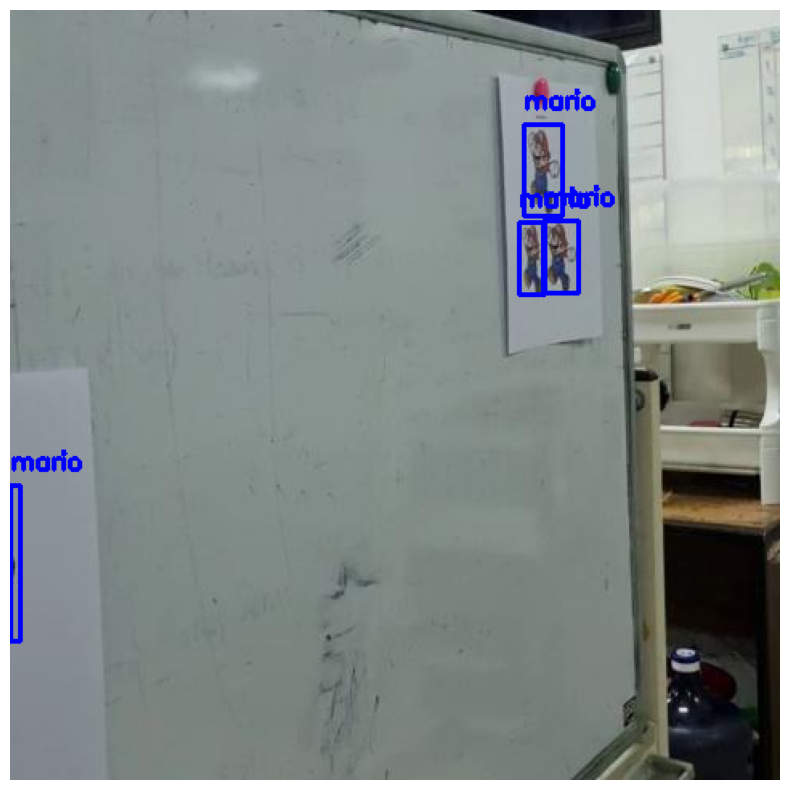

Processed image OTV5-mp4_frame_960_jpg.rf.36a6afae3cd6590c0c6b4faa207af879.jpg in 0.3333 seconds

0: 480x480 1 mario, 18.8ms
Speed: 1.1ms preprocess, 18.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


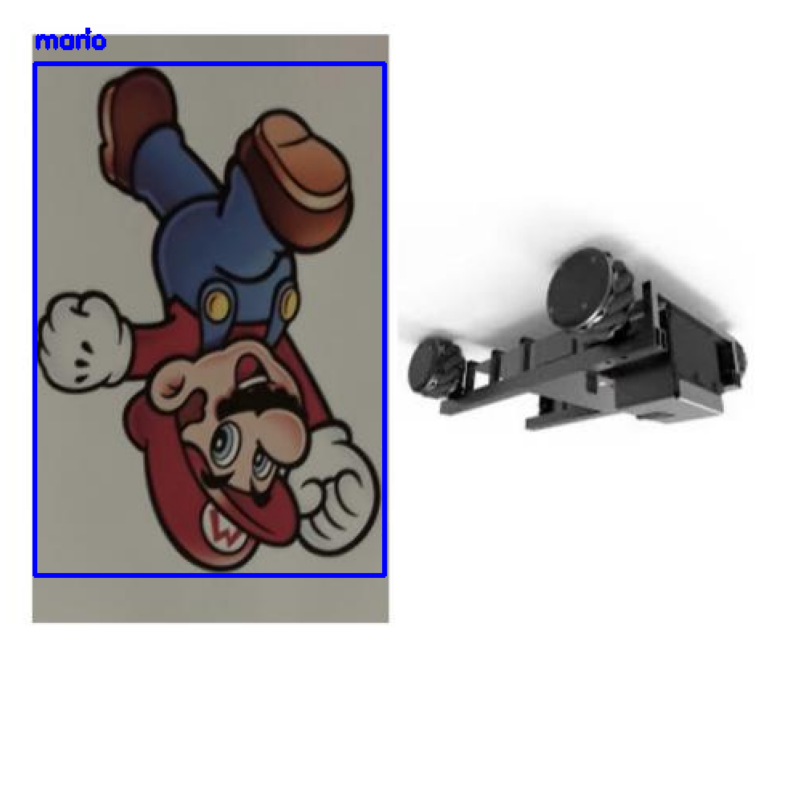

Processed image F4D39092-72C6-4971-9B4F-680845D9B930_jpg.rf.3e37236e95fe3af2363869648e15c5f1.jpg in 0.3065 seconds

0: 480x480 3 marios, 19.2ms
Speed: 1.3ms preprocess, 19.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


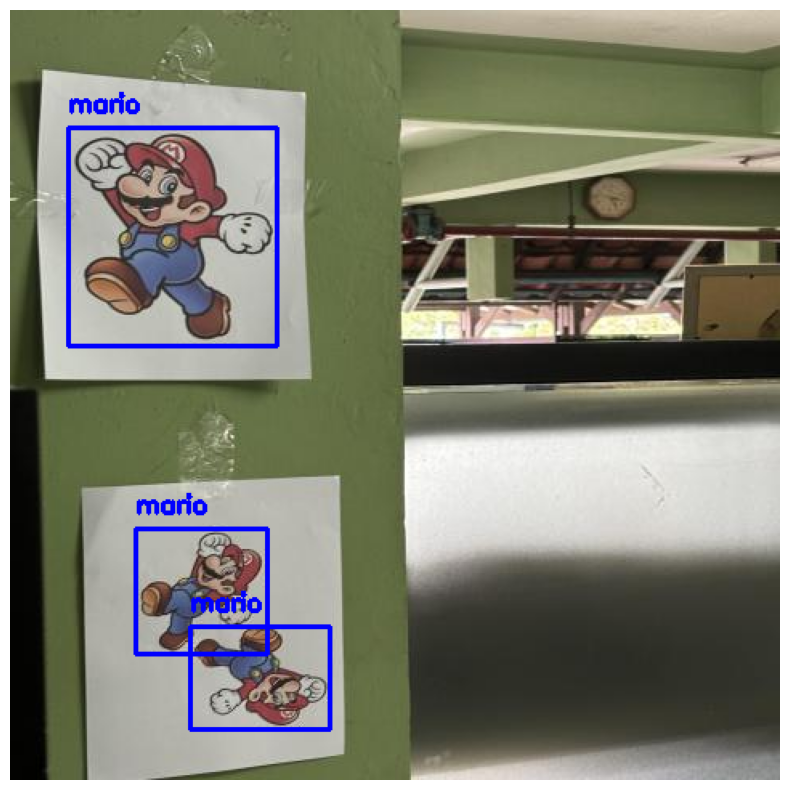

Processed image IMG_1712_jpg.rf.5b440e0b3590d7ee5ee1cb74d9a598bb.jpg in 0.3995 seconds

0: 480x480 11 marios, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


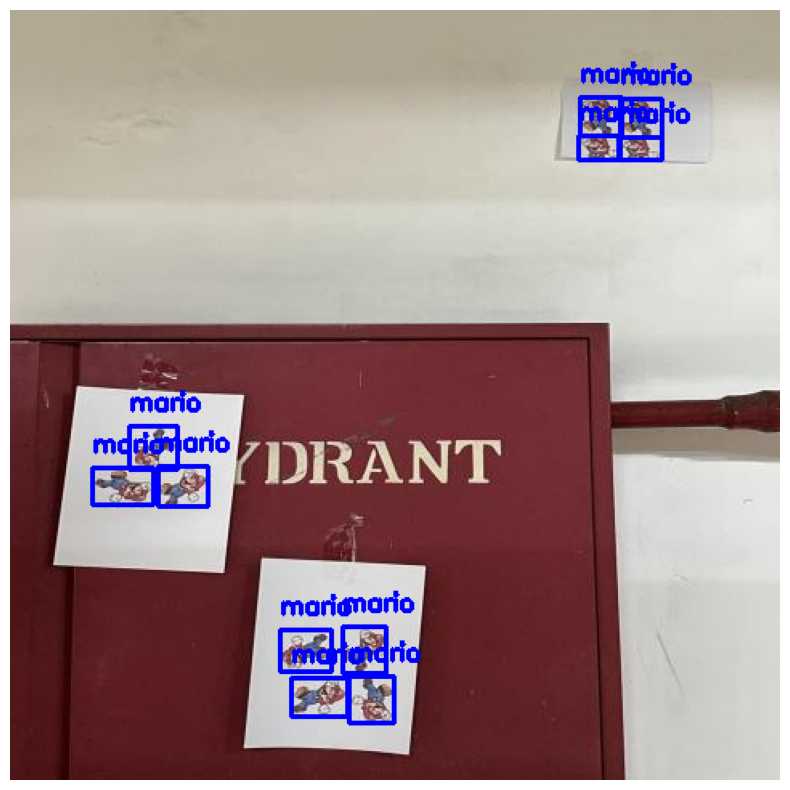

Processed image IMG_1756_jpg.rf.12cb72c11c550536b72c36fbc44b6519.jpg in 0.3504 seconds

0: 480x480 1 mario, 18.0ms
Speed: 1.4ms preprocess, 18.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


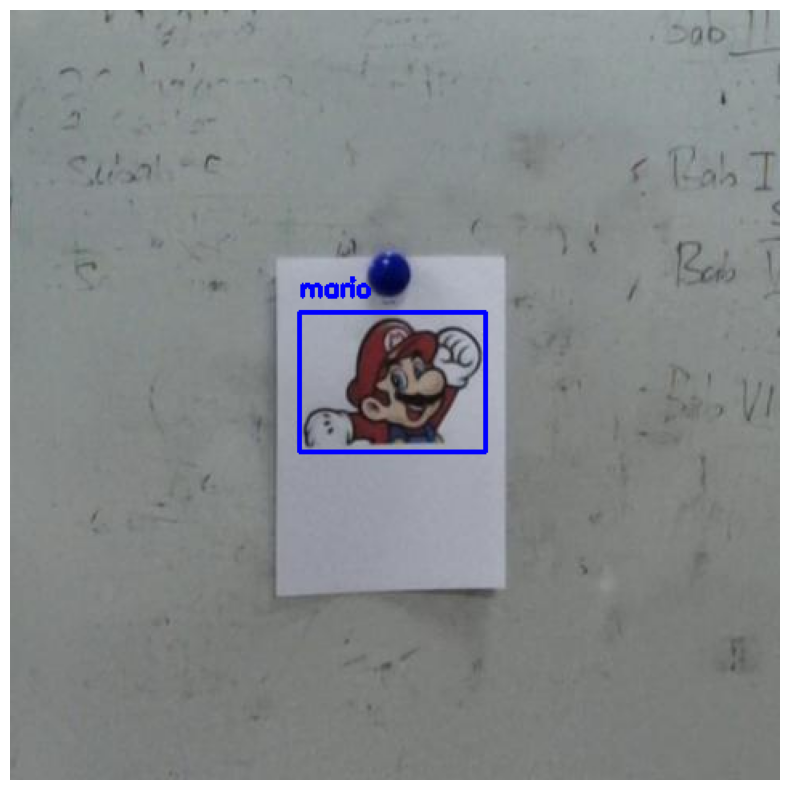

Processed image OTV1-mp4_frame_930_jpg.rf.154e957a53ab45c62d3d0c3fe6a198ee.jpg in 0.2866 seconds

0: 480x480 4 marios, 18.9ms
Speed: 1.4ms preprocess, 18.9ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


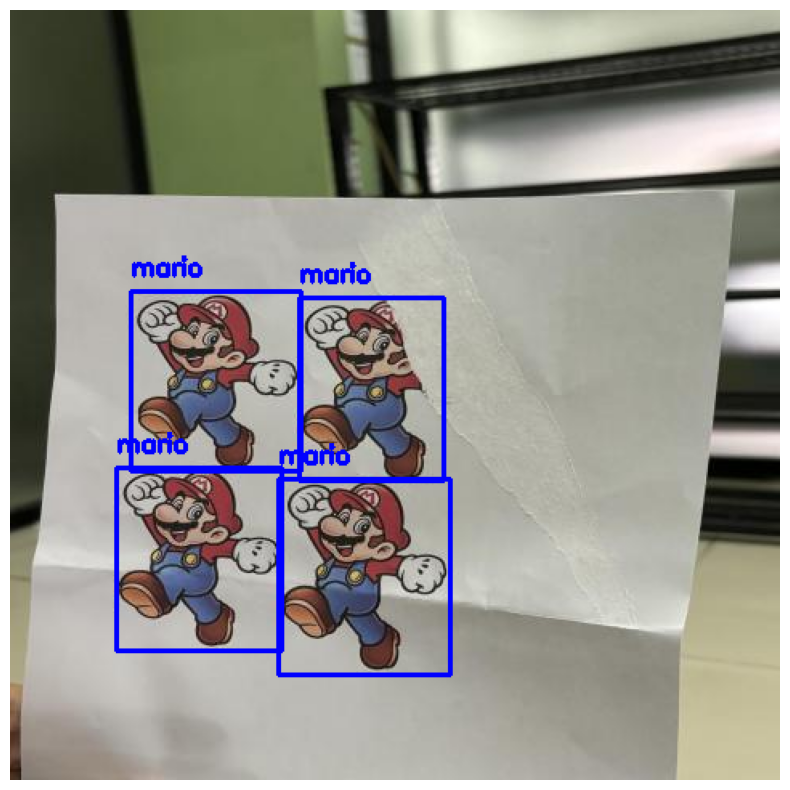

Processed image IMG_1767_jpg.rf.0127cd6b098f7649b18f9c2a8b69dc8c.jpg in 0.3120 seconds

0: 480x480 1 mario, 20.1ms
Speed: 1.5ms preprocess, 20.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


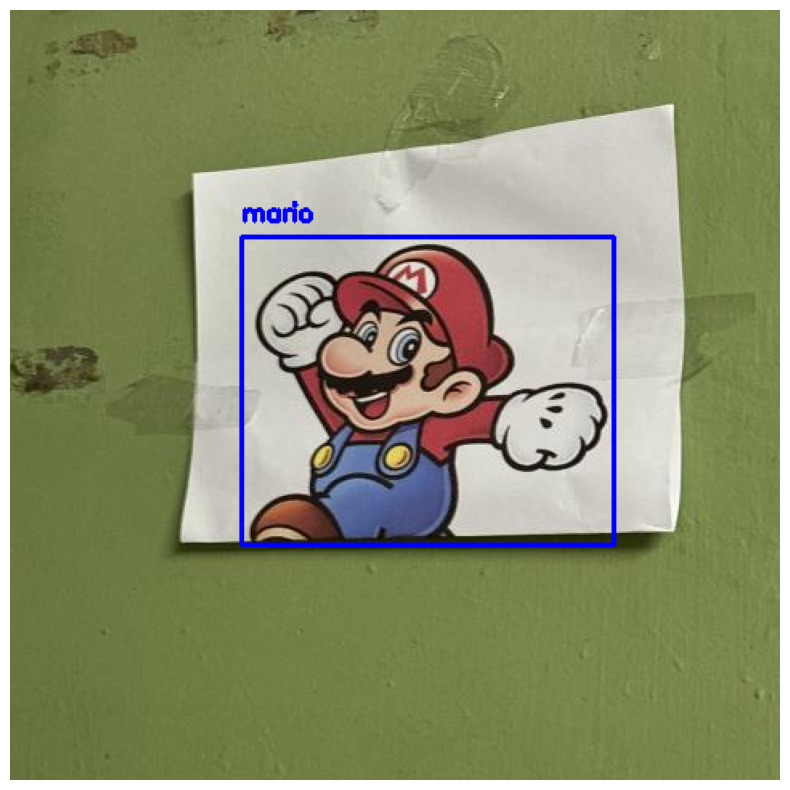

Processed image IMG_1716_jpg.rf.db4531c160655824614180358f7b584e.jpg in 0.3263 seconds

0: 480x480 3 marios, 20.0ms
Speed: 1.8ms preprocess, 20.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


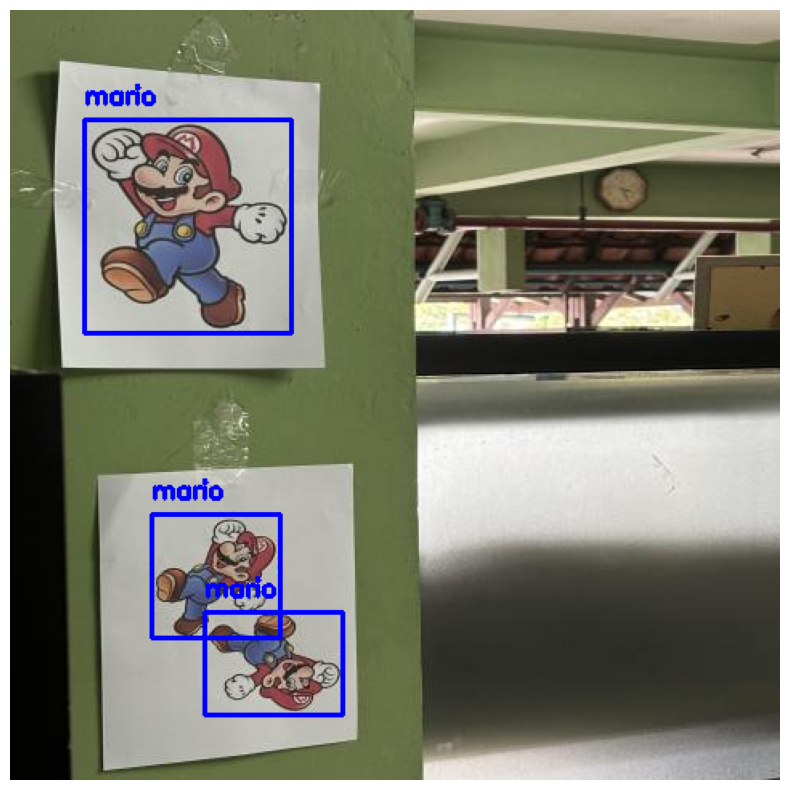

Processed image IMG_1713_jpg.rf.1e4ccfbc9de8bff60da87c800bcc9ffb.jpg in 0.3307 seconds

0: 480x480 1 mario, 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


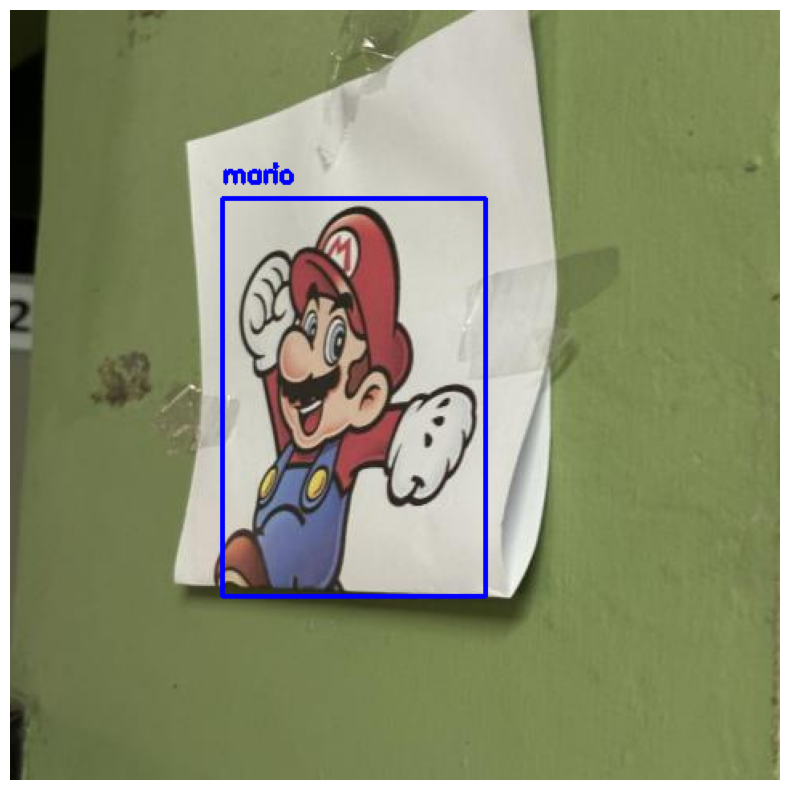

Processed image IMG_1730_jpg.rf.124e4dece5a82d87e640ae60f0e5ede7.jpg in 0.2912 seconds

0: 480x480 1 mario, 18.7ms
Speed: 3.1ms preprocess, 18.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


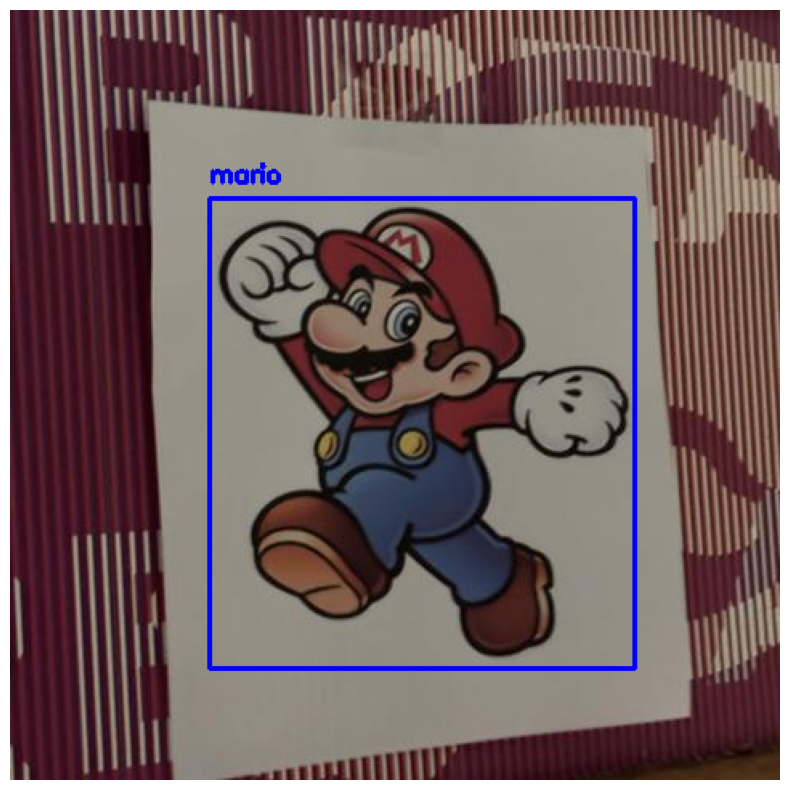

Processed image IMG_1762_jpg.rf.653a02b07d7c290b70d1c955a1c73096.jpg in 0.3674 seconds

0: 480x480 1 mario, 20.6ms
Speed: 1.4ms preprocess, 20.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


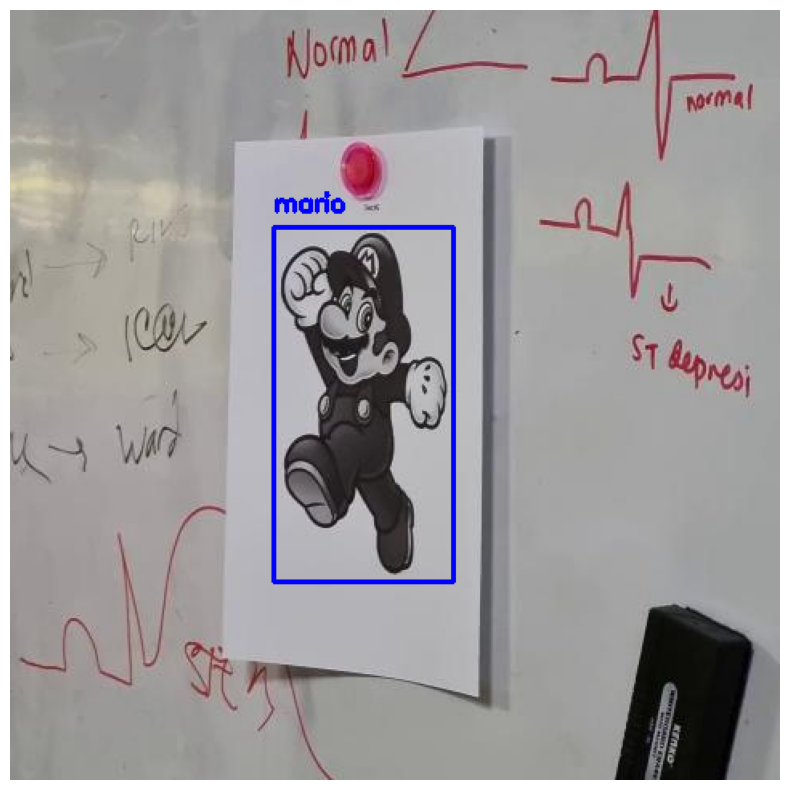

Processed image OTV4-mp4_frame_780_jpg.rf.b6f7c305ea27437c0157d91445b5274a.jpg in 0.2745 seconds

0: 480x480 1 mario, 18.0ms
Speed: 1.3ms preprocess, 18.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


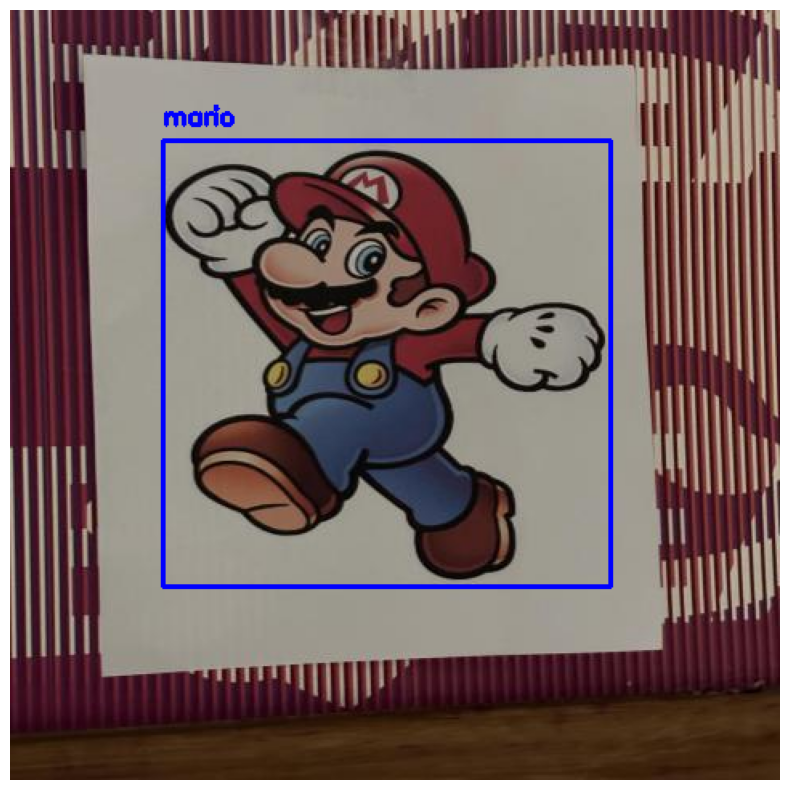

Processed image IMG_1691_jpg.rf.dc73cdeb69e3651a1c85eed959c8a73a.jpg in 0.3648 seconds

0: 480x480 1 mario, 19.8ms
Speed: 1.5ms preprocess, 19.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


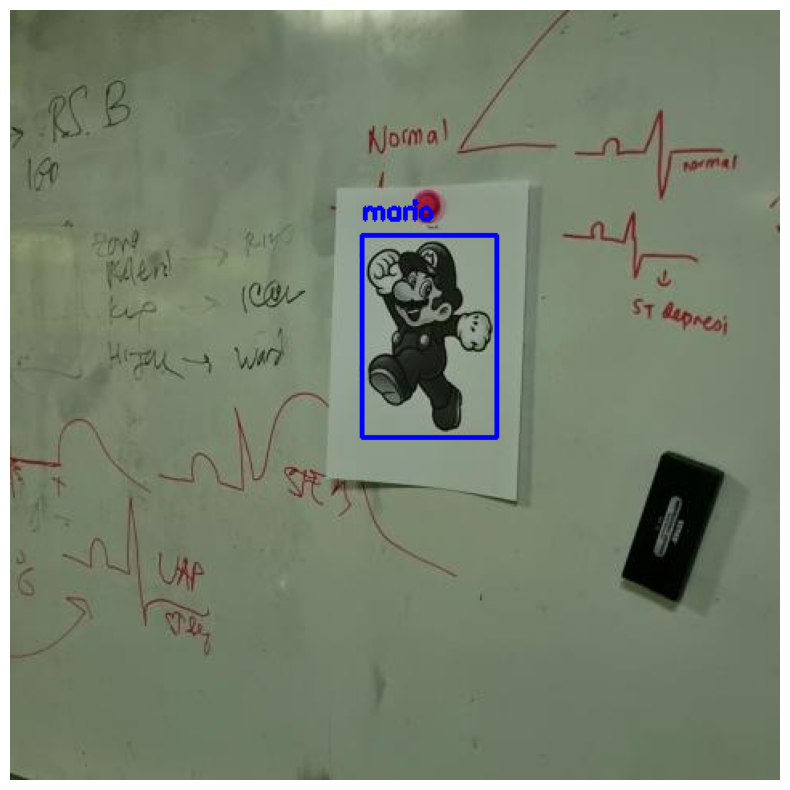

Processed image OTV2-mp4_frame_30_jpg.rf.12dfa4680284b5ec23bb0aa582ec1559.jpg in 0.2666 seconds

0: 480x480 1 mario, 18.7ms
Speed: 1.4ms preprocess, 18.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


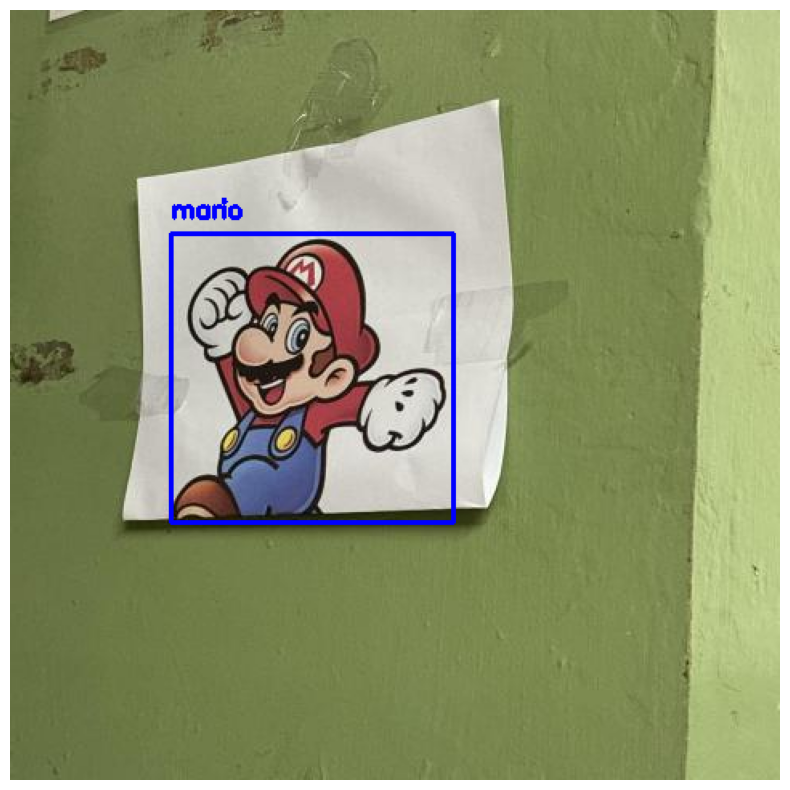

Processed image IMG_1728_jpg.rf.9af6555bffc4245d05c00951aa8058e1.jpg in 0.3931 seconds

0: 480x480 3 marios, 18.1ms
Speed: 1.3ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


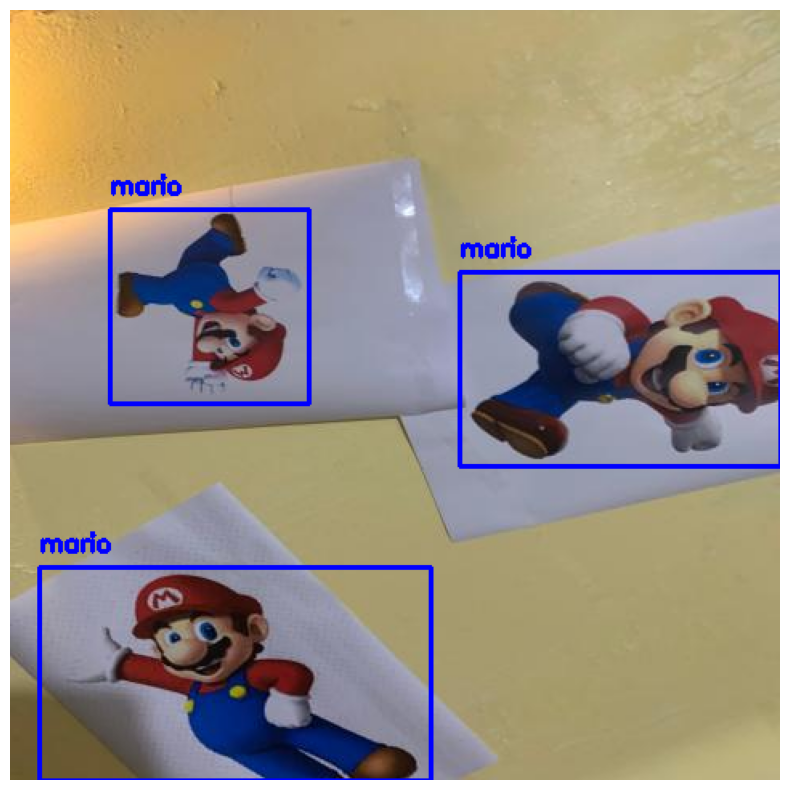

Processed image IMG-20241203-WA0061_jpg.rf.16cc647ee78244236c17a7876f90a6dd.jpg in 0.4079 seconds

0: 480x480 3 marios, 18.0ms
Speed: 2.5ms preprocess, 18.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


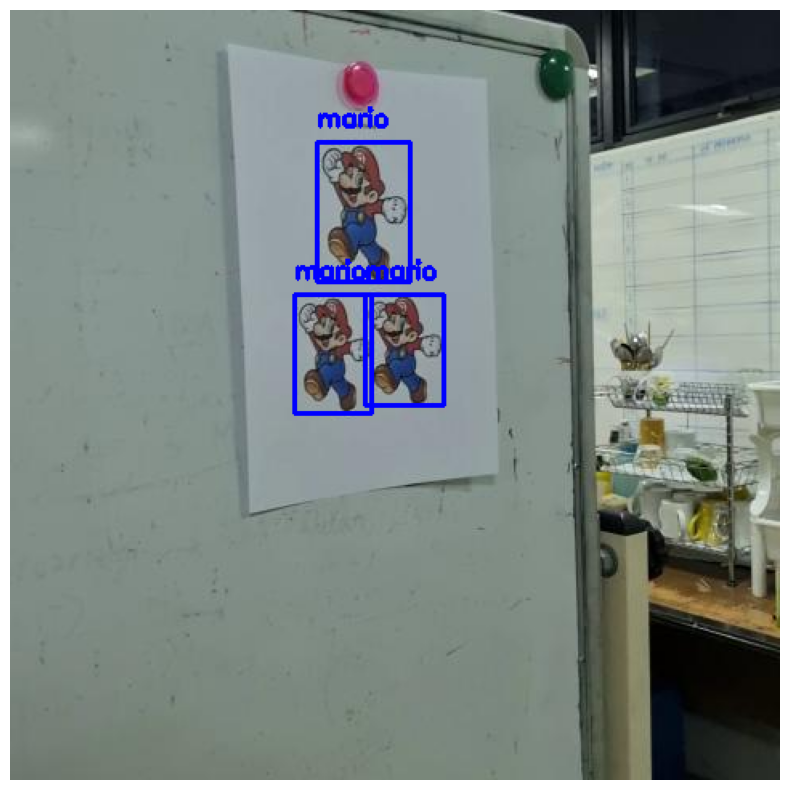

Processed image OTV2-mp4_frame_360_jpg.rf.4599585d2be2d12dbc2dce98895e509f.jpg in 0.3553 seconds

0: 480x480 1 mario, 18.0ms
Speed: 1.2ms preprocess, 18.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


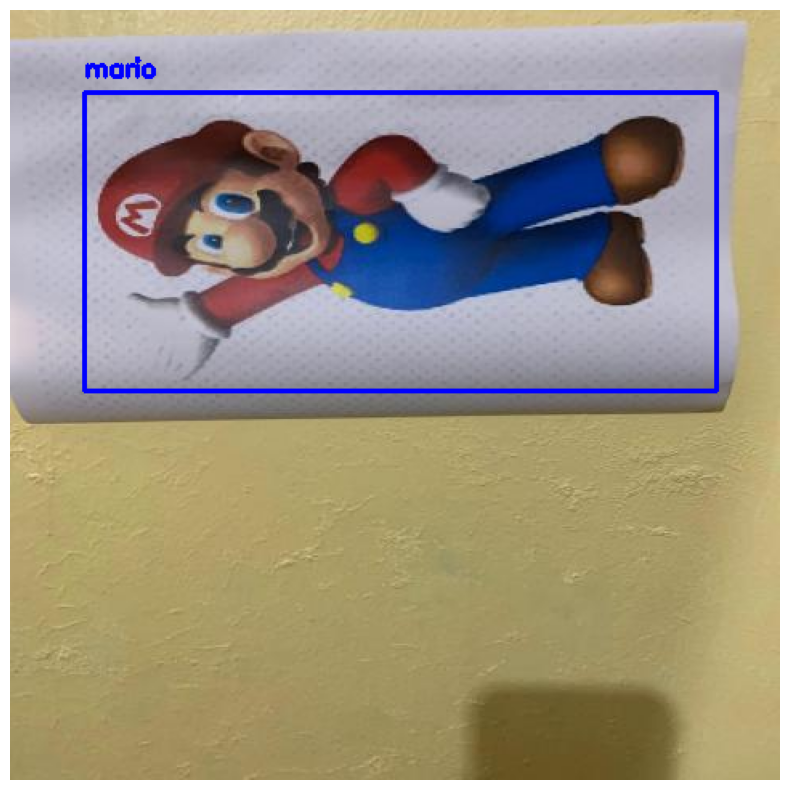

Processed image ae9119dc-2d63-430d-8ad1-e7145a7180c2_jpg.rf.5cf361dcf9228726b5517263db83bad7.jpg in 0.4398 seconds

0: 480x480 3 marios, 18.1ms
Speed: 1.0ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


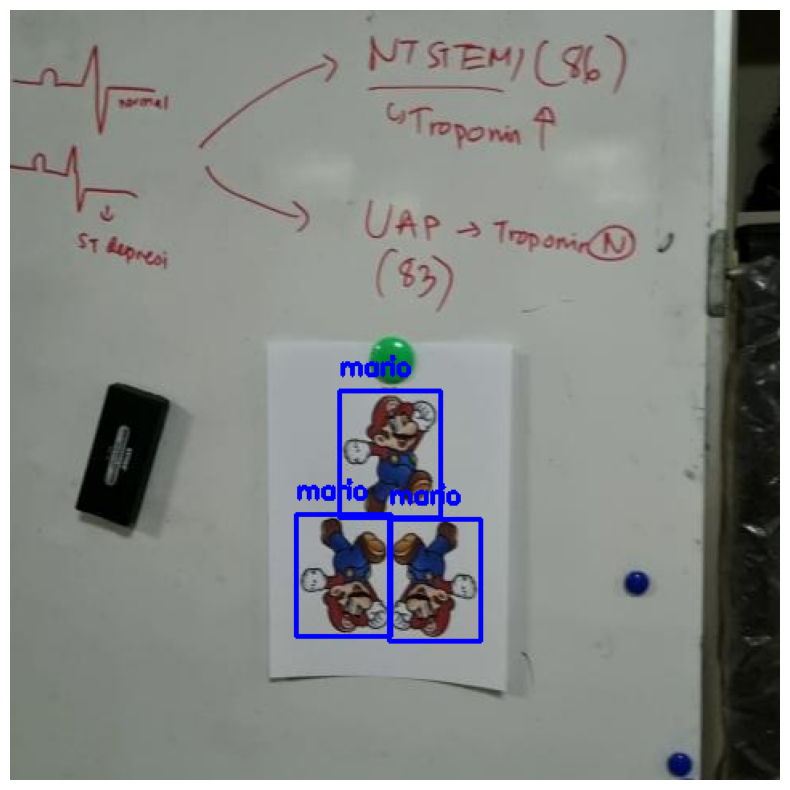

Processed image OTV2-mp4_frame_120_jpg.rf.c0c4af0139de83105222d1da4b99759c.jpg in 0.3360 seconds

0: 480x480 11 marios, 18.1ms
Speed: 2.7ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


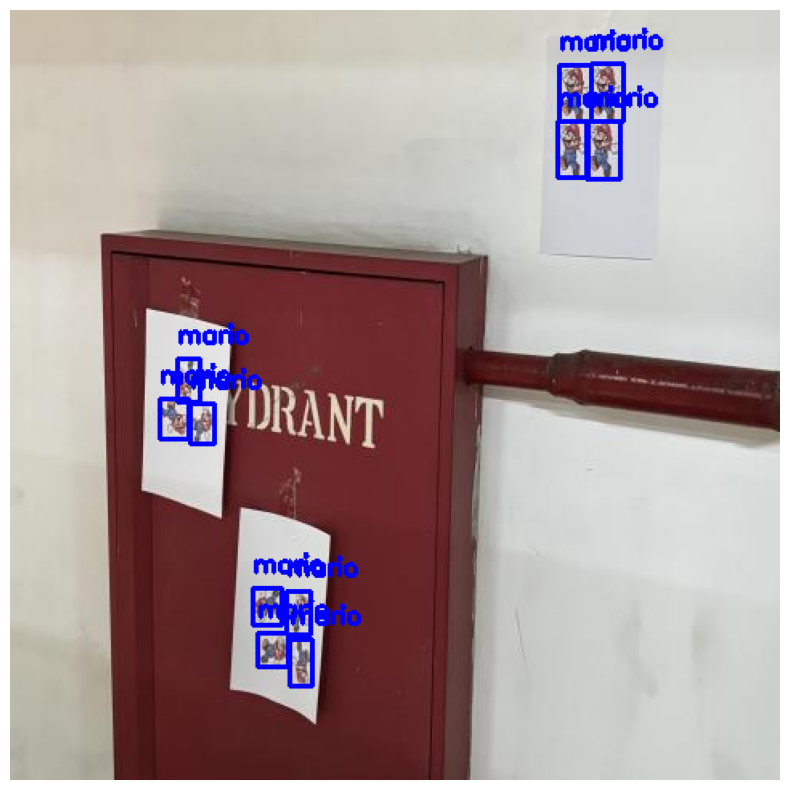

Processed image IMG_1670_jpg.rf.e8eb9a5cddb12f4c7619ff4fe3991073.jpg in 0.3395 seconds

0: 480x480 4 marios, 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


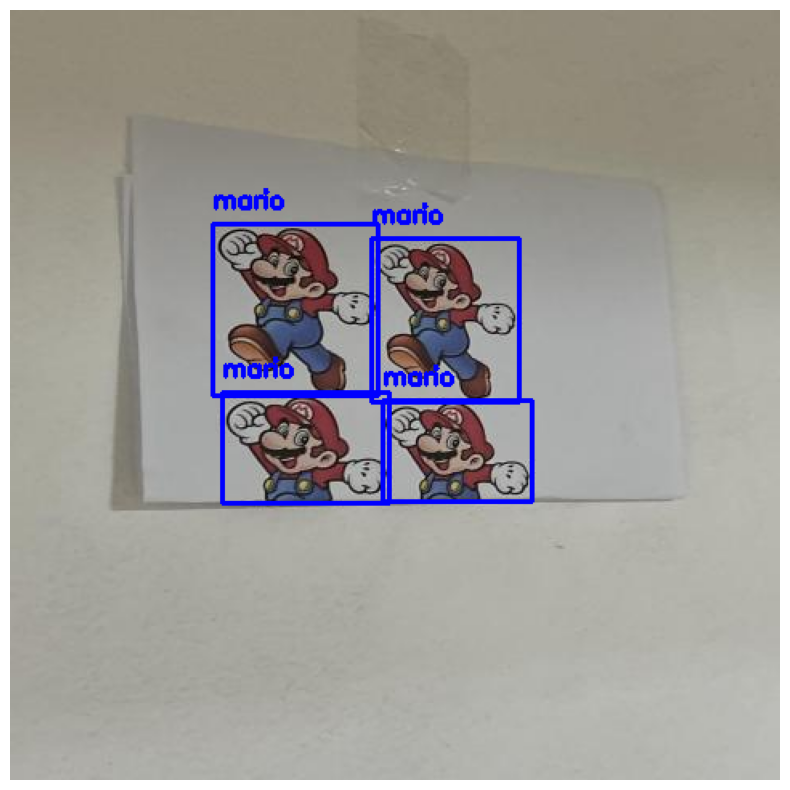

Processed image IMG_1746_jpg.rf.1e787befa7559780415cd434b59b3d1f.jpg in 0.2468 seconds

0: 480x480 1 mario, 18.7ms
Speed: 1.4ms preprocess, 18.7ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


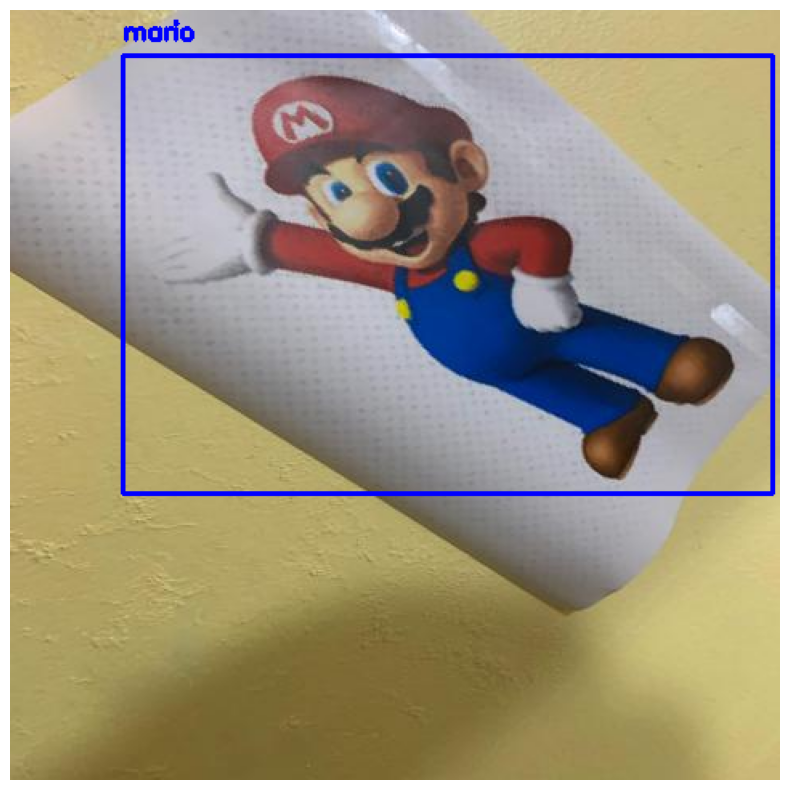

Processed image 1979b18c-04ce-4e68-92cd-744e7f7417d9_jpg.rf.9e94c36de1eb3bf1e6c47dc25bd83c09.jpg in 0.3863 seconds

0: 480x480 3 marios, 18.1ms
Speed: 2.5ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


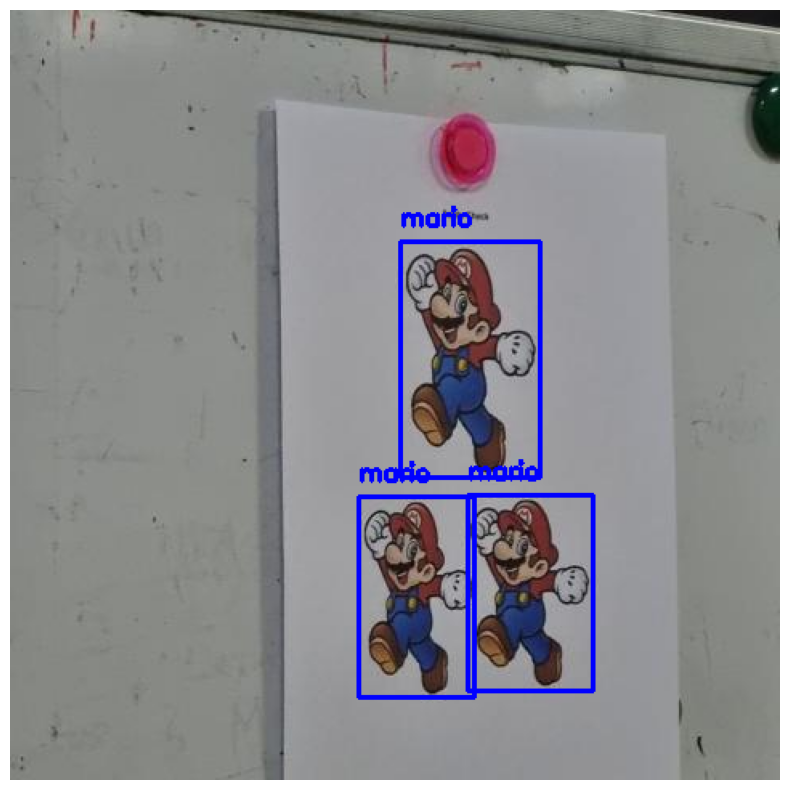

Processed image OTV3-mp4_frame_270_jpg.rf.ac5fae4ca8314d4a5e2d18be67c3690d.jpg in 0.3222 seconds

0: 480x480 3 marios, 18.6ms
Speed: 1.3ms preprocess, 18.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


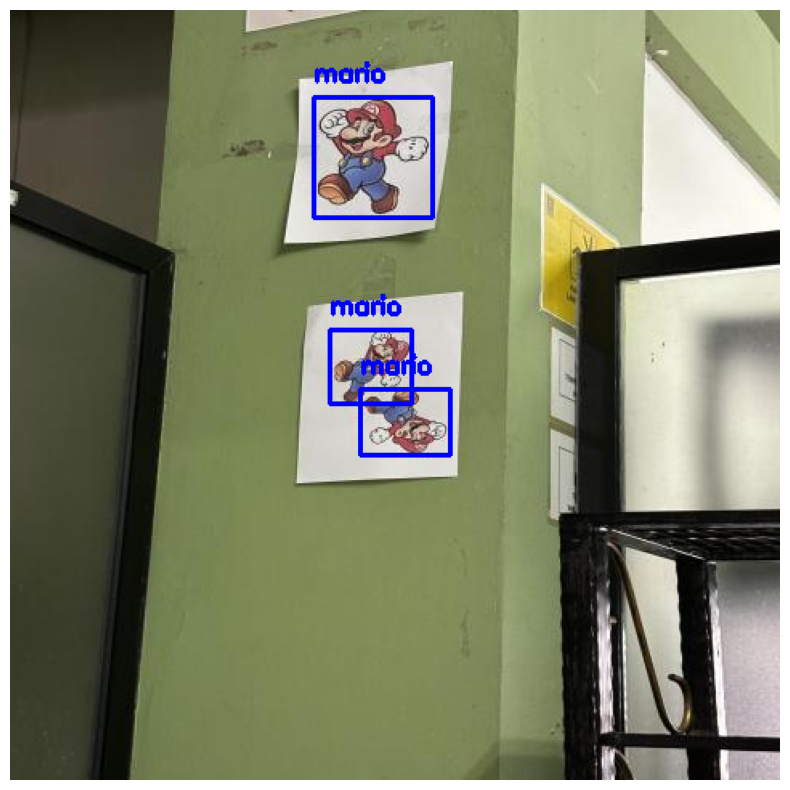

Processed image IMG_1683_jpg.rf.6e509023deed5ce78f9a21a48d3416b7.jpg in 0.3747 seconds

0: 480x480 2 marios, 19.6ms
Speed: 1.5ms preprocess, 19.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


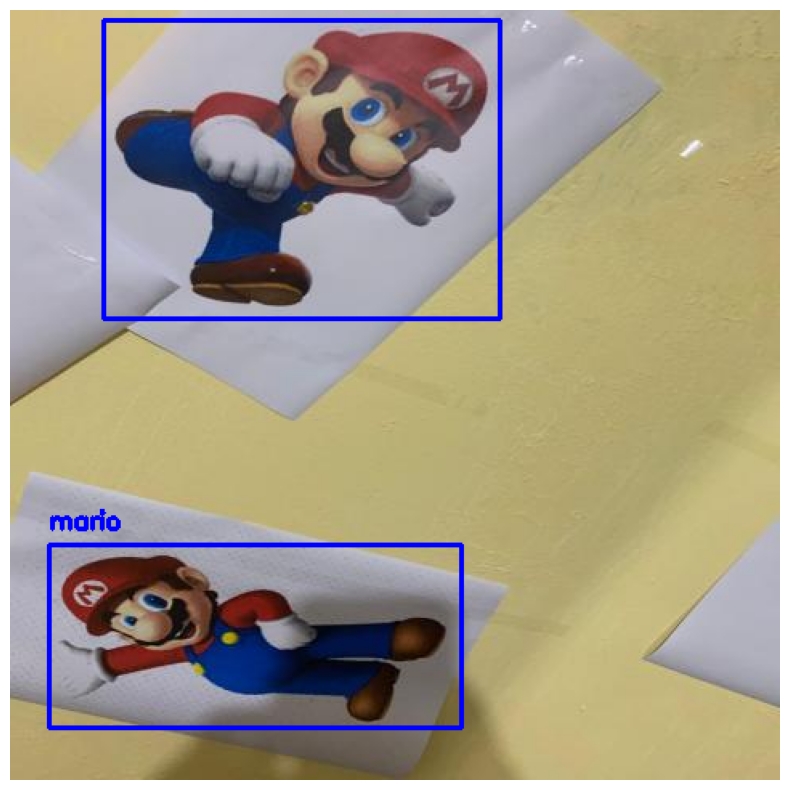

Processed image 48b33737-9ee8-4395-830d-111660885159-1-_jpg.rf.3e878a44020298fc59e37f19256d8e01.jpg in 0.4195 seconds

0: 480x480 3 marios, 19.5ms
Speed: 3.2ms preprocess, 19.5ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


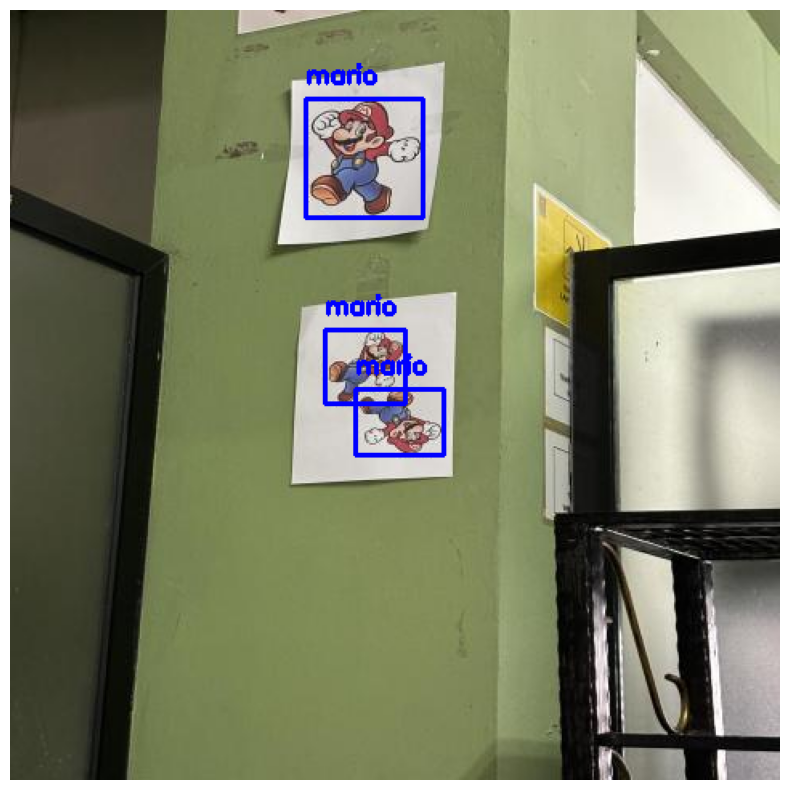

Processed image IMG_1684_jpg.rf.9b37f5aa3233c7d762d1f6b6533b149e.jpg in 0.3917 seconds

0: 480x480 1 mario, 19.4ms
Speed: 1.5ms preprocess, 19.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


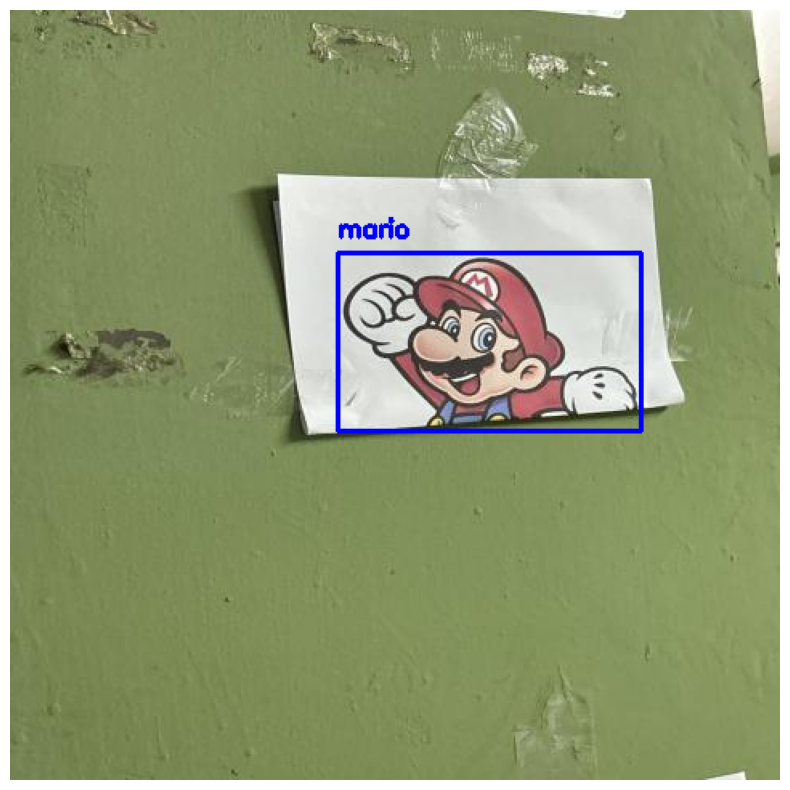

Processed image IMG_1737_jpg.rf.56295e4dfd583026a254fc4eae167608.jpg in 0.3101 seconds

0: 480x480 2 marios, 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


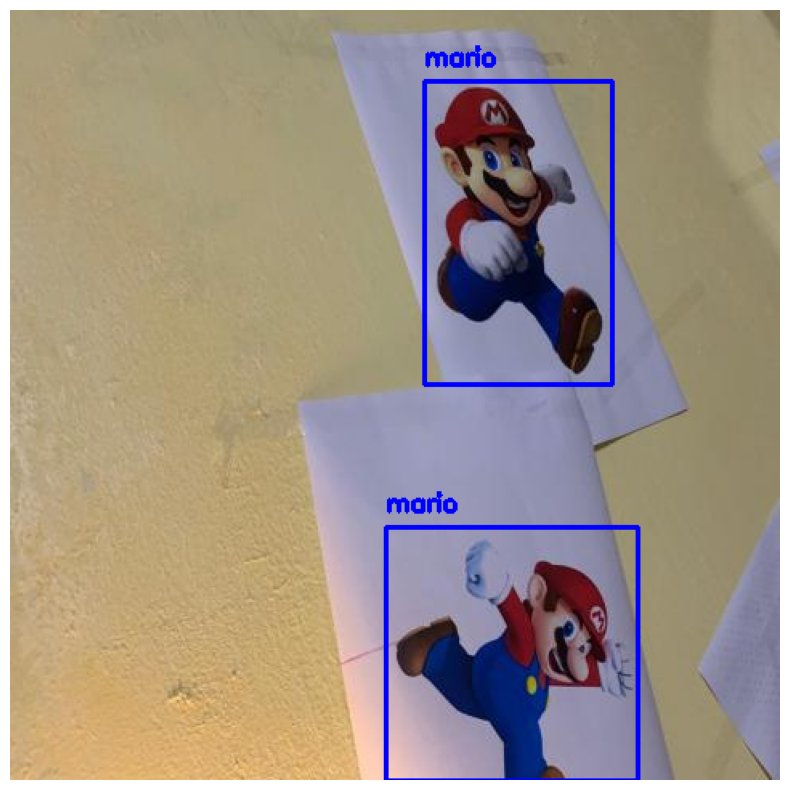

Processed image 37909f4a-1b8d-4a5d-bd38-5970596b6da1_jpg.rf.09984bf85914b0bfe3496ca745228b8b.jpg in 0.3531 seconds

0: 480x480 2 marios, 18.0ms
Speed: 2.6ms preprocess, 18.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


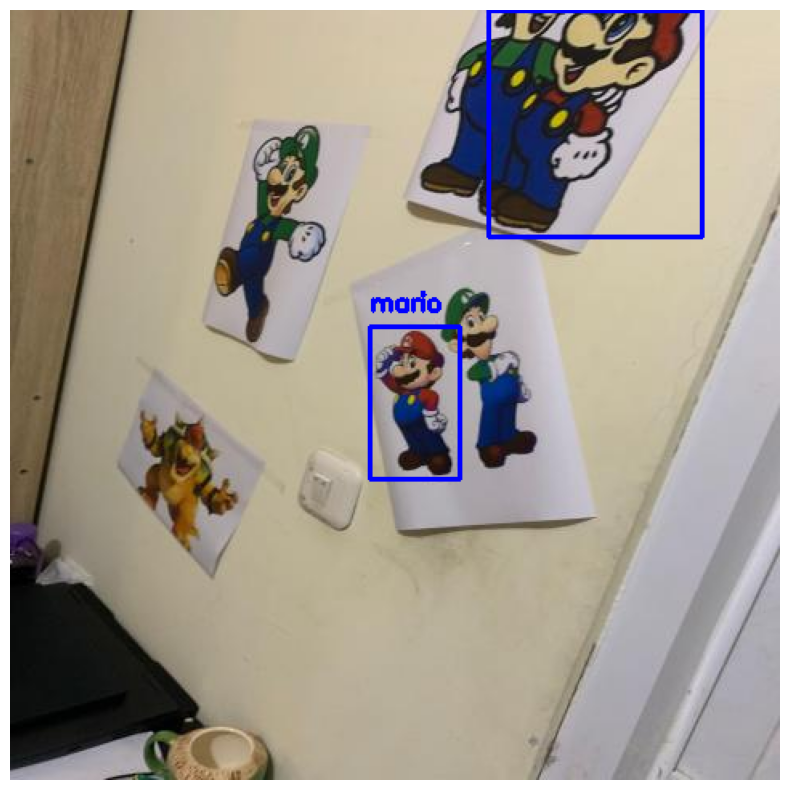

Processed image bfdfe2ba-fd95-429f-a669-4efd01c71225_jpg.rf.e10ca81440f55806fa1e4b16065ca651.jpg in 0.3930 seconds

0: 480x480 1 mario, 18.1ms
Speed: 1.4ms preprocess, 18.1ms inference, 1.6ms postprocess per image at shape (1, 3, 480, 480)


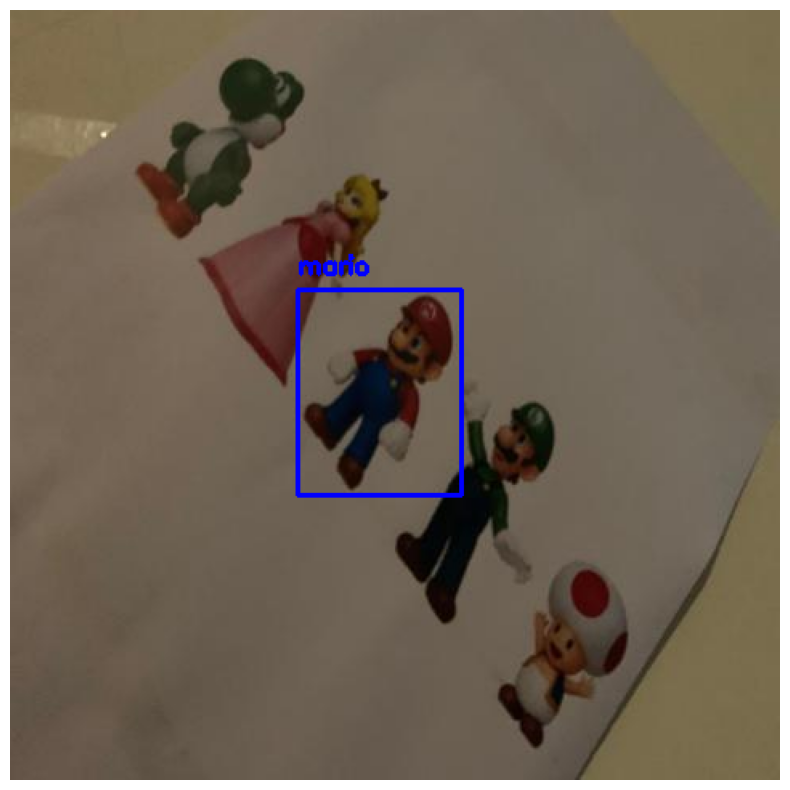

Processed image IMG-20241203-WA0036_jpg.rf.c7f0305447f6f0b4ad96cdb7a55b45bc.jpg in 0.3184 seconds

0: 480x480 1 mario, 18.2ms
Speed: 2.2ms preprocess, 18.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


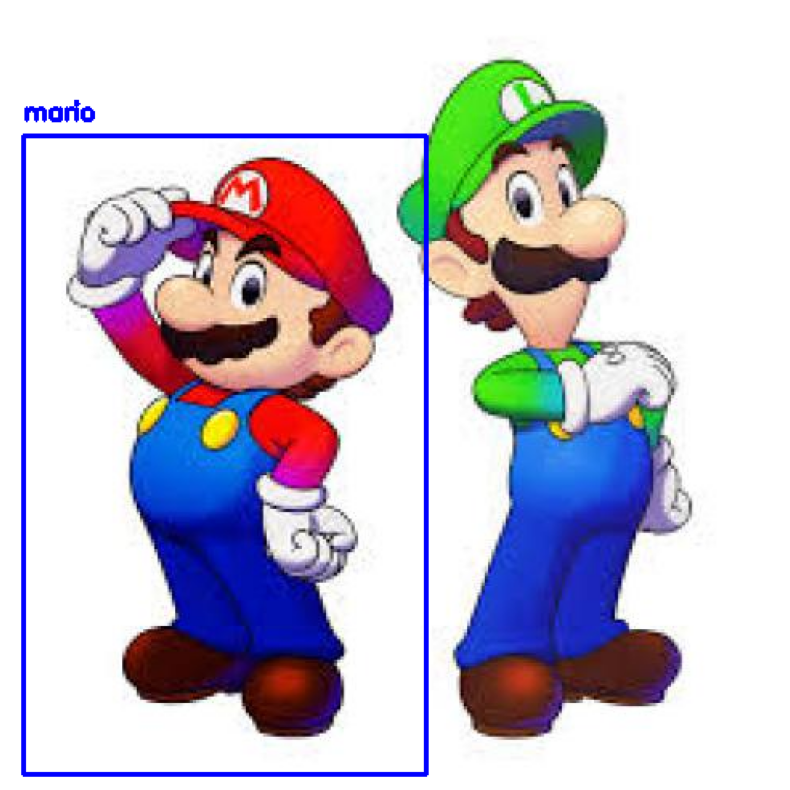

Processed image IMG_1933_JPG.rf.59ae02852beeeca5c5e013768c88f2c7.jpg in 0.4006 seconds

0: 480x480 4 marios, 18.0ms
Speed: 2.8ms preprocess, 18.0ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


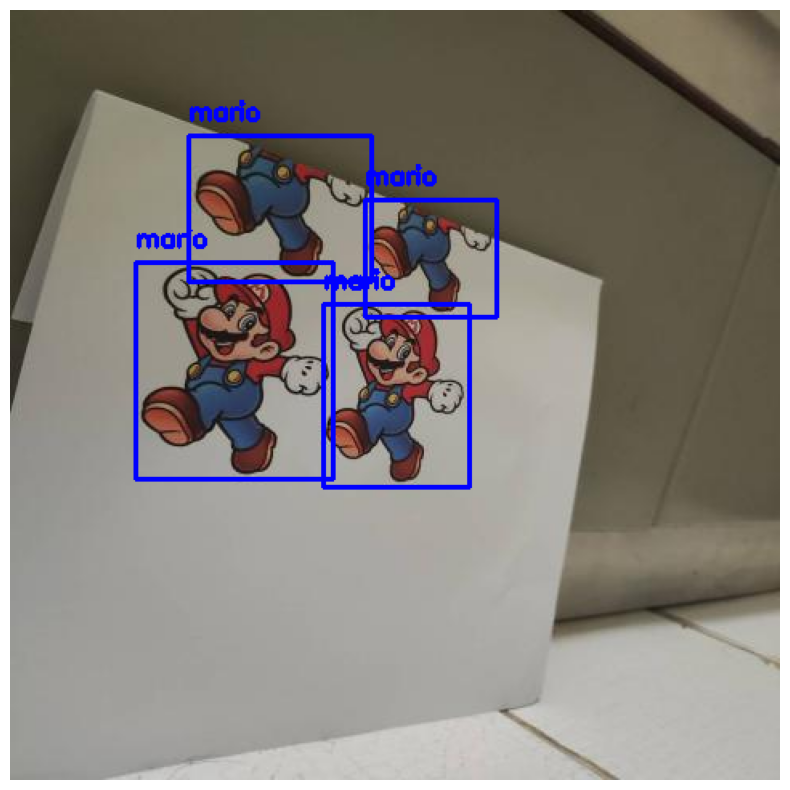

Processed image 580368_0_jpg.rf.8ba92f7e02c58f998aa43db69f9ee68d.jpg in 0.3223 seconds

0: 480x480 1 mario, 18.1ms
Speed: 1.2ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


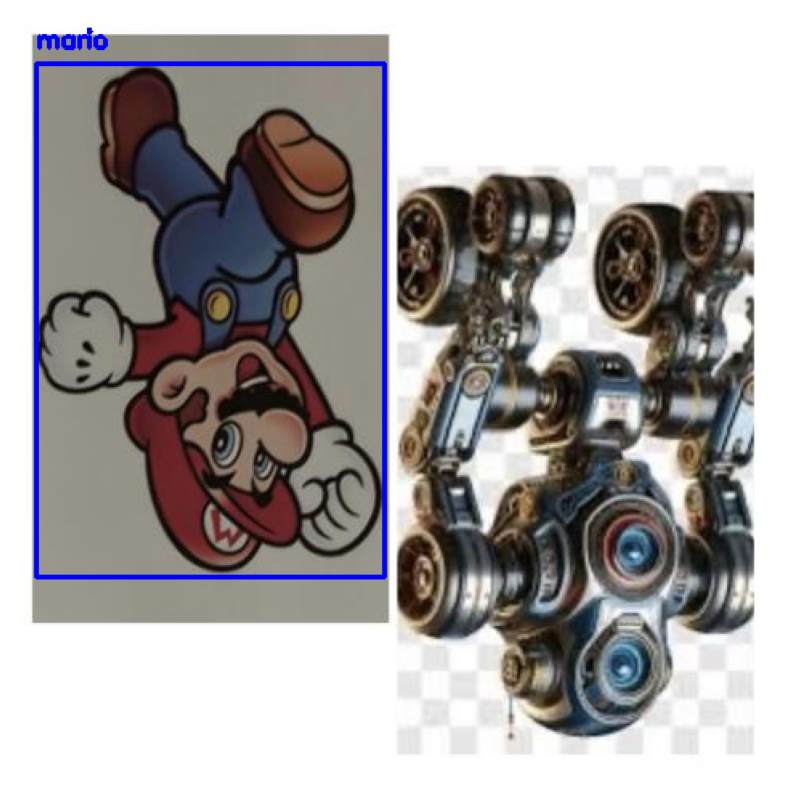

Processed image 18D78F8E-DCD2-4DED-B23D-AD67B290C018_jpg.rf.dbcba79743b10467b17fce7349c934f0.jpg in 0.4020 seconds

0: 480x480 1 mario, 18.1ms
Speed: 1.4ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


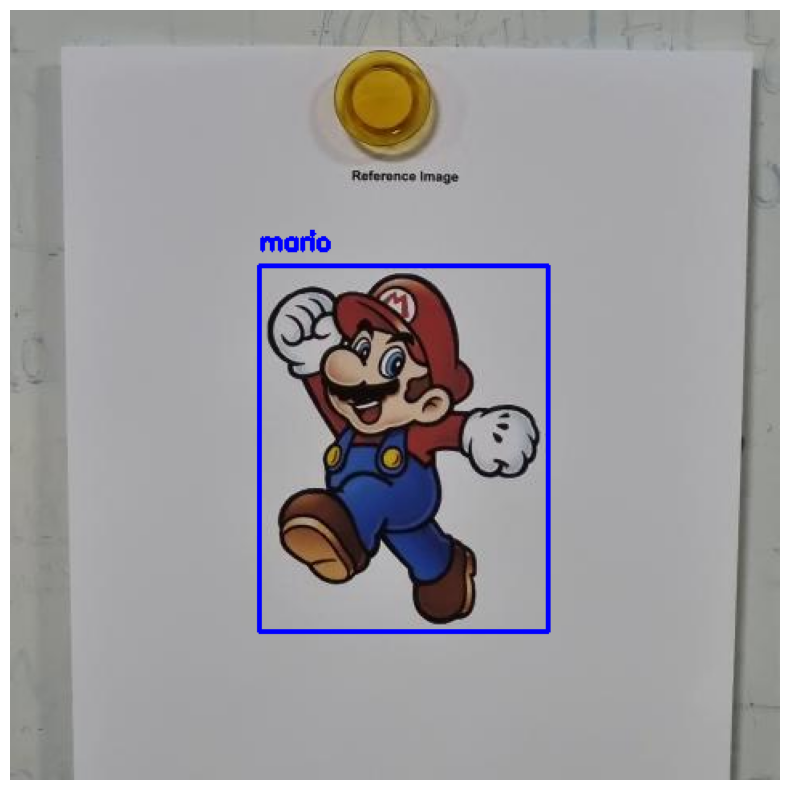

Processed image OTV4-mp4_frame_30_jpg.rf.694749a9fc9f1f866e1d021618b9942b.jpg in 0.3021 seconds

0: 480x480 4 marios, 18.1ms
Speed: 1.3ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


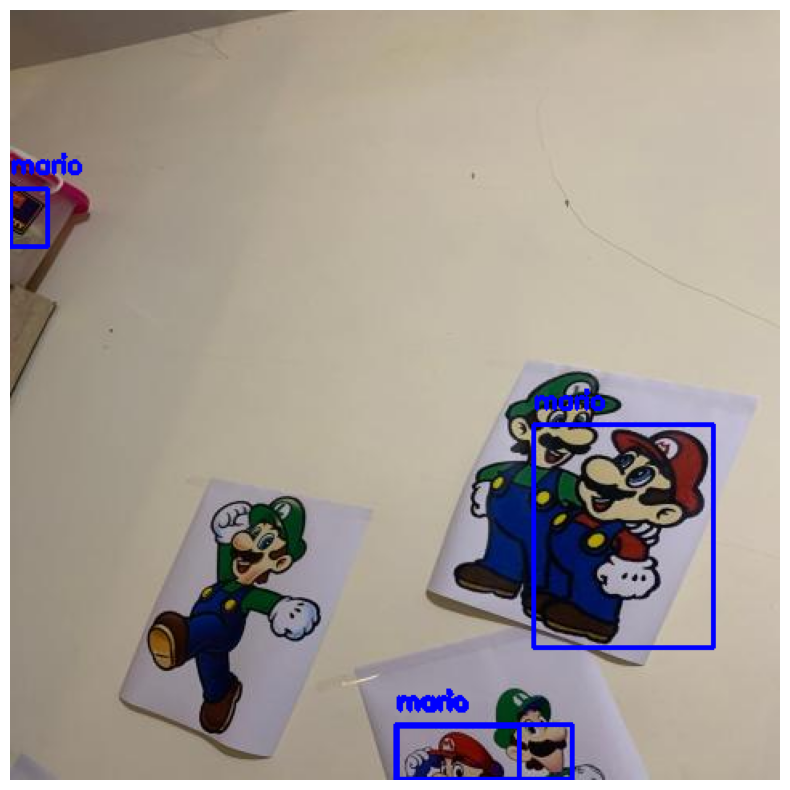

Processed image e93a9872-9191-4710-8311-e8478e13d37d_jpg.rf.d71c1b9080f651416e9a2f57a7c5e348.jpg in 0.3418 seconds

0: 480x480 3 marios, 19.1ms
Speed: 1.6ms preprocess, 19.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


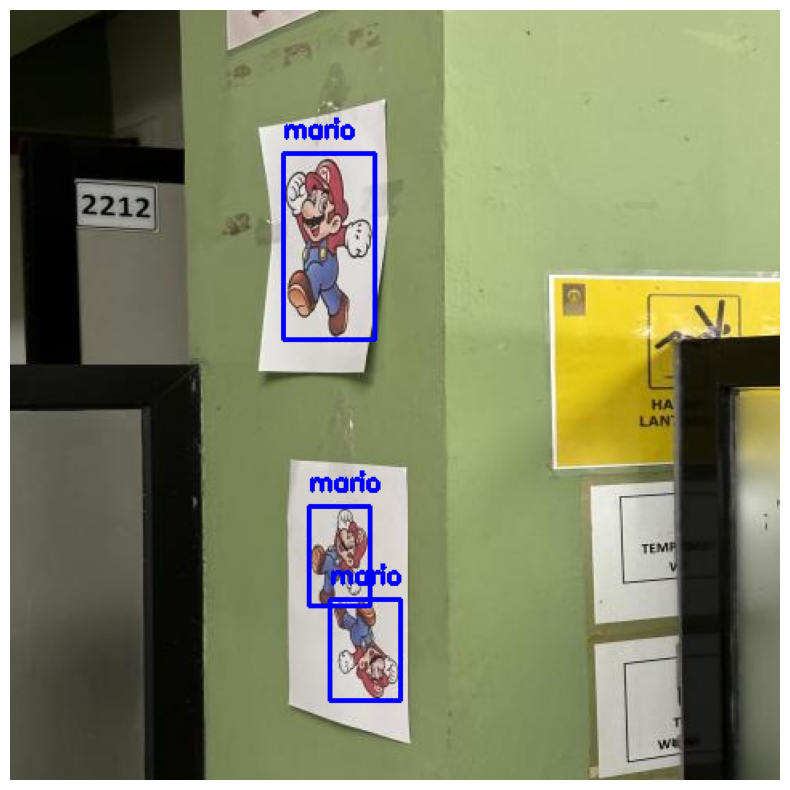

Processed image IMG_1708_jpg.rf.186ae5d9677897c314b8a033a014a70c.jpg in 0.3292 seconds

0: 480x480 1 mario, 19.7ms
Speed: 1.6ms preprocess, 19.7ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


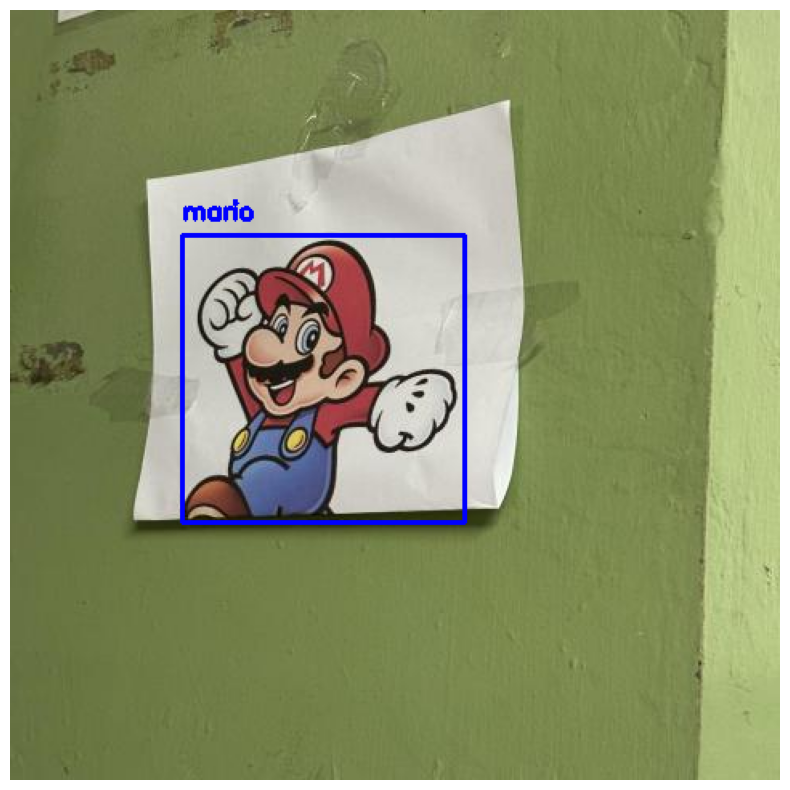

Processed image IMG_1727_jpg.rf.e3c6b39643c610782d52daee0ba47a89.jpg in 0.3926 seconds

0: 480x480 3 marios, 19.3ms
Speed: 1.6ms preprocess, 19.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


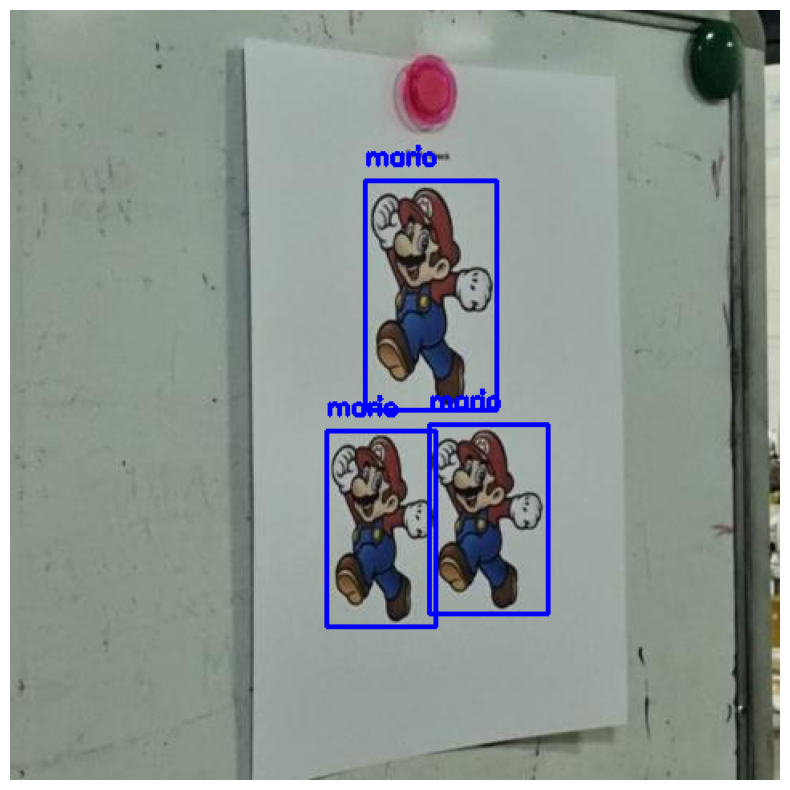

Processed image OTV1-mp4_frame_330_jpg.rf.d365c6a6e58f0fbca591af7a5fc4fe68.jpg in 0.3544 seconds

0: 480x480 1 mario, 19.3ms
Speed: 1.6ms preprocess, 19.3ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


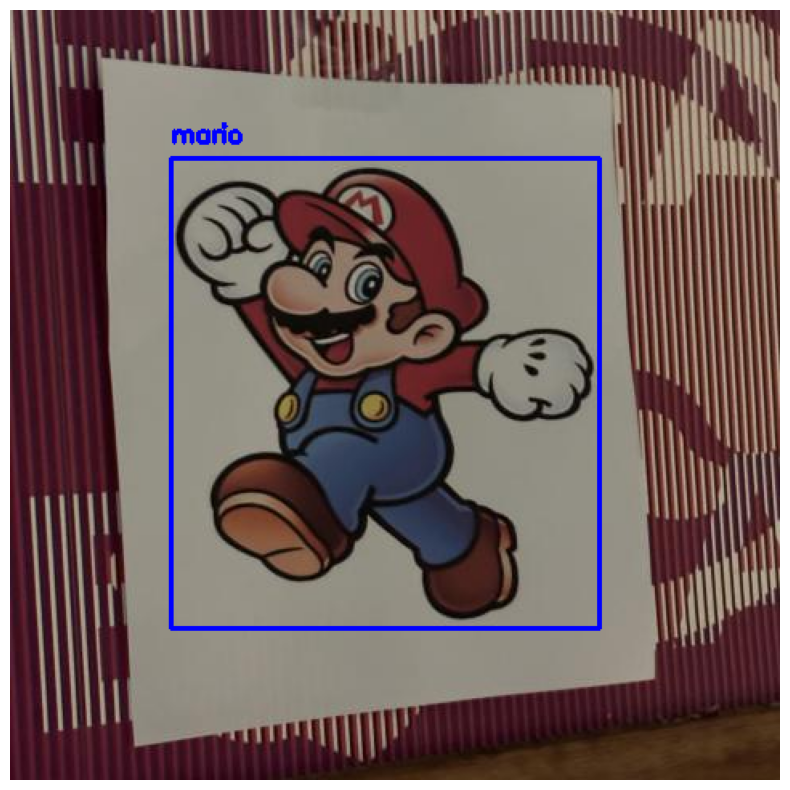

Processed image IMG_1763_jpg.rf.9cb21a056e1feb058a2e2c4d16cc242a.jpg in 0.4478 seconds

0: 480x480 7 marios, 20.6ms
Speed: 1.6ms preprocess, 20.6ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


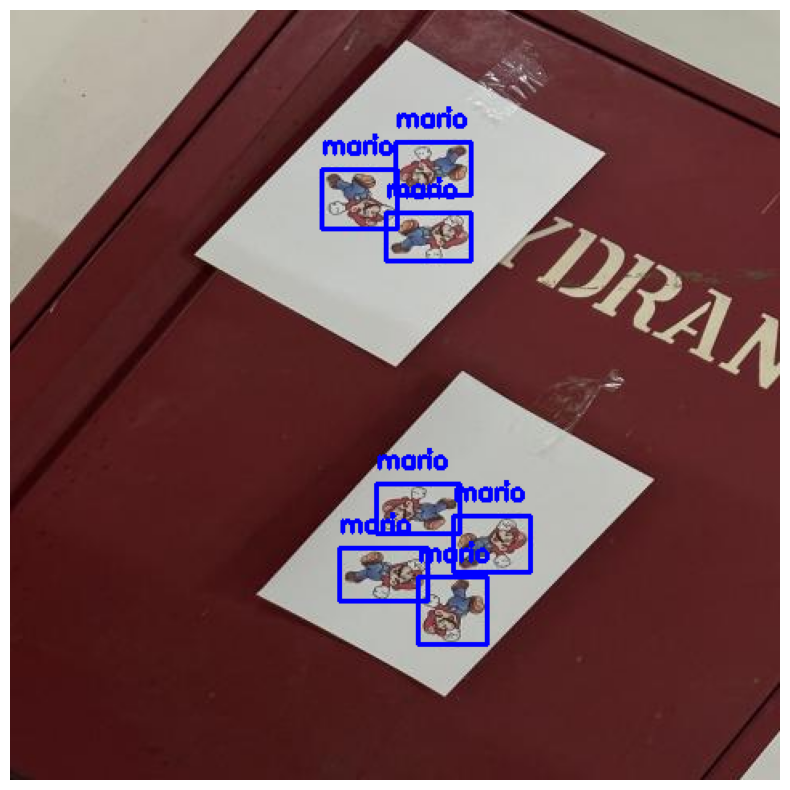

Processed image IMG_1695_jpg.rf.a4879c3039f76f6958ad9c48b49636a3.jpg in 0.3540 seconds

0: 480x480 11 marios, 19.8ms
Speed: 1.5ms preprocess, 19.8ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


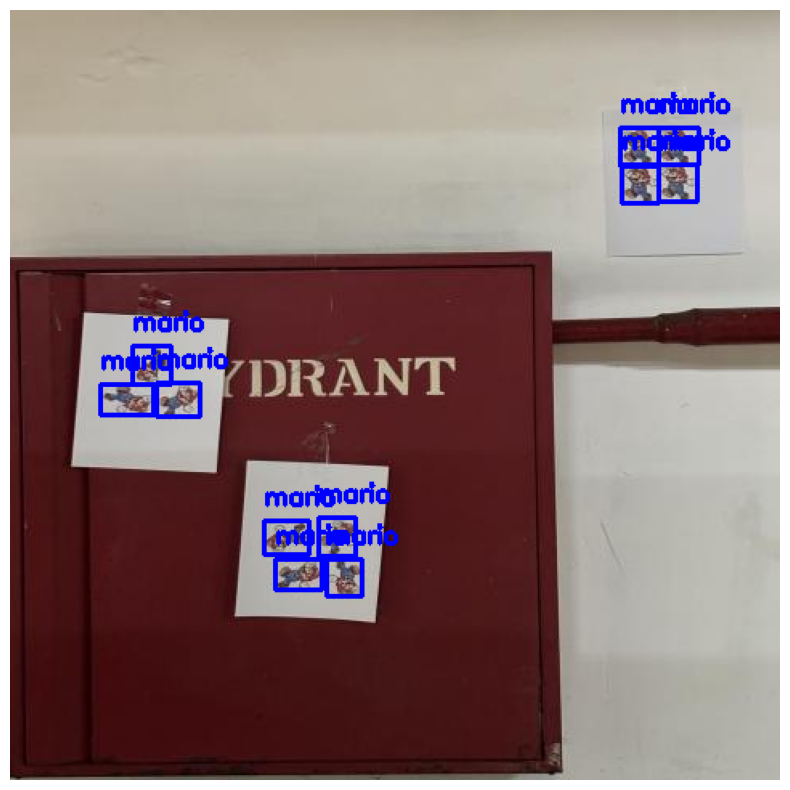

Processed image IMG_1698_jpg.rf.395d004997dc950def6282a161d9e850.jpg in 0.3358 seconds

0: 480x480 1 mario, 18.1ms
Speed: 1.1ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


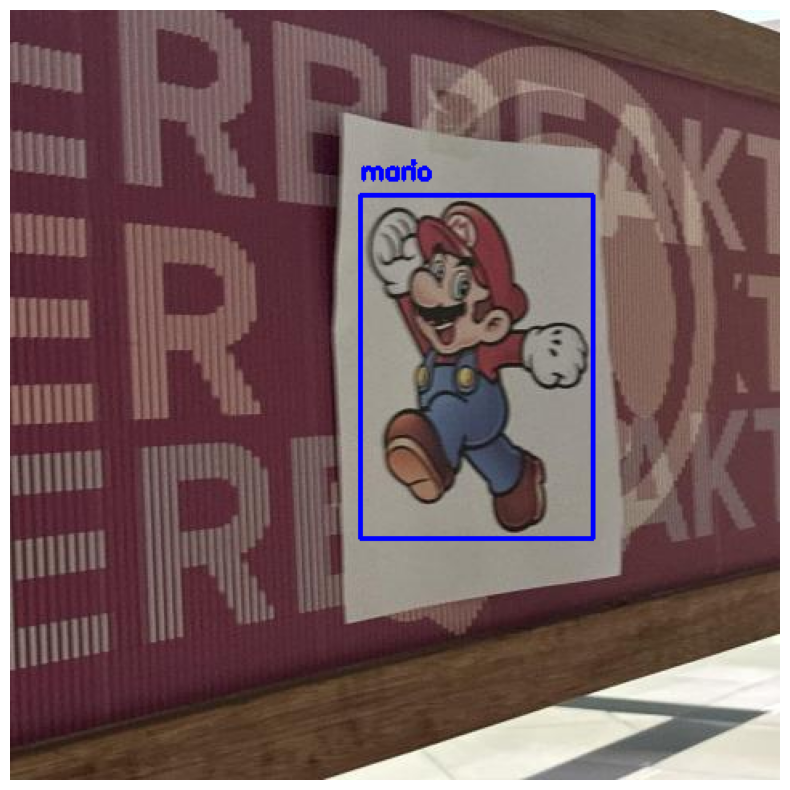

Processed image IMG_1706_jpg.rf.b318688d73ad9dae209d33d68d641552.jpg in 0.4771 seconds

0: 480x480 4 marios, 20.5ms
Speed: 1.5ms preprocess, 20.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


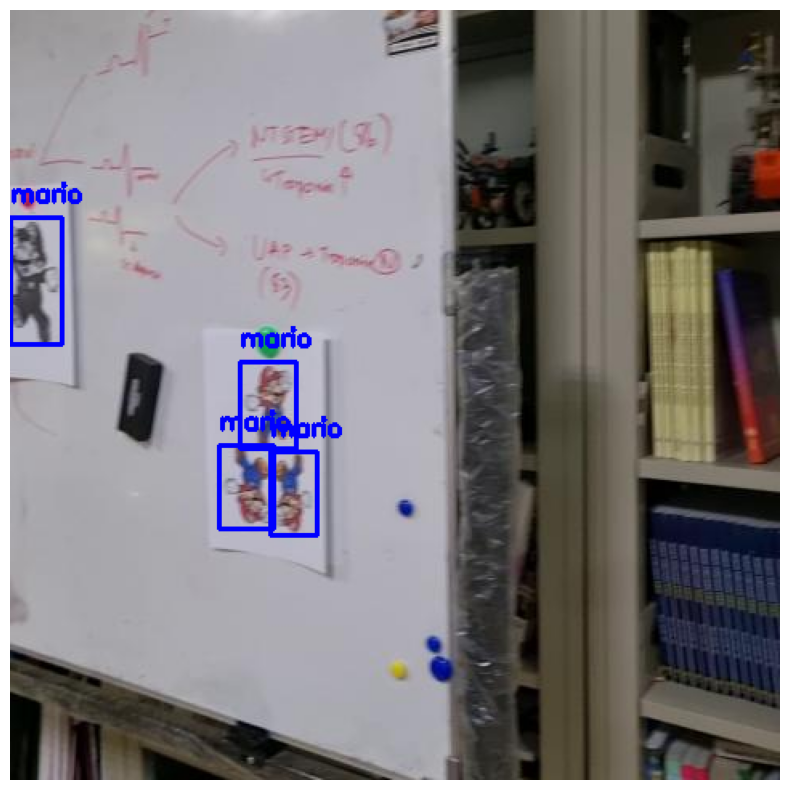

Processed image OTV4-mp4_frame_510_jpg.rf.d1fcdf56103929486d8bf19dadc6a99b.jpg in 0.3896 seconds

0: 480x480 3 marios, 18.1ms
Speed: 1.3ms preprocess, 18.1ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


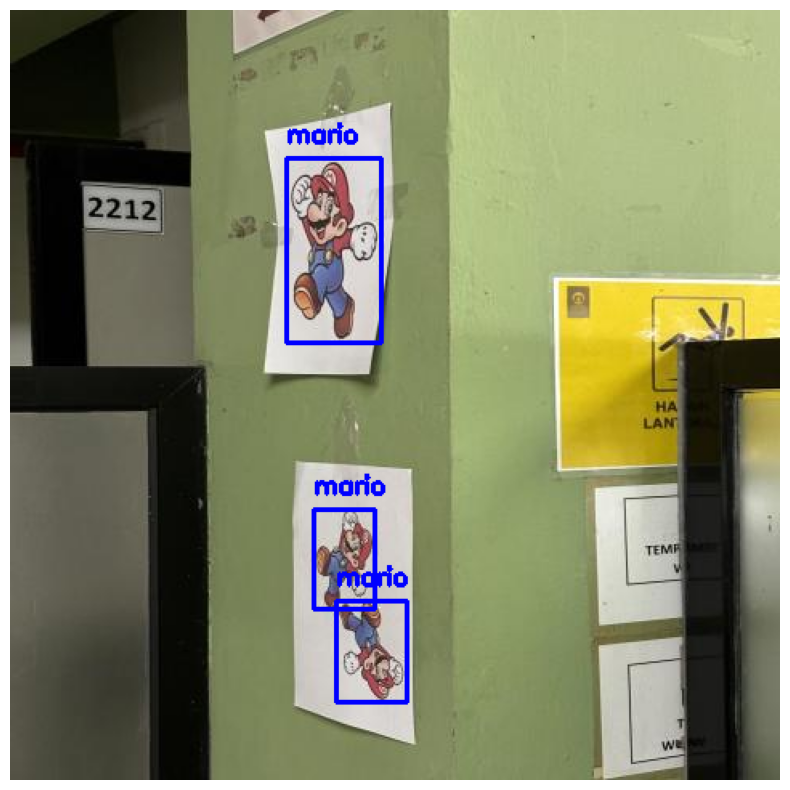

Processed image IMG_1707_jpg.rf.0c7d583d421874e5ec179e639f08a8a7.jpg in 0.3850 seconds

0: 480x480 1 mario, 19.1ms
Speed: 1.5ms preprocess, 19.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)


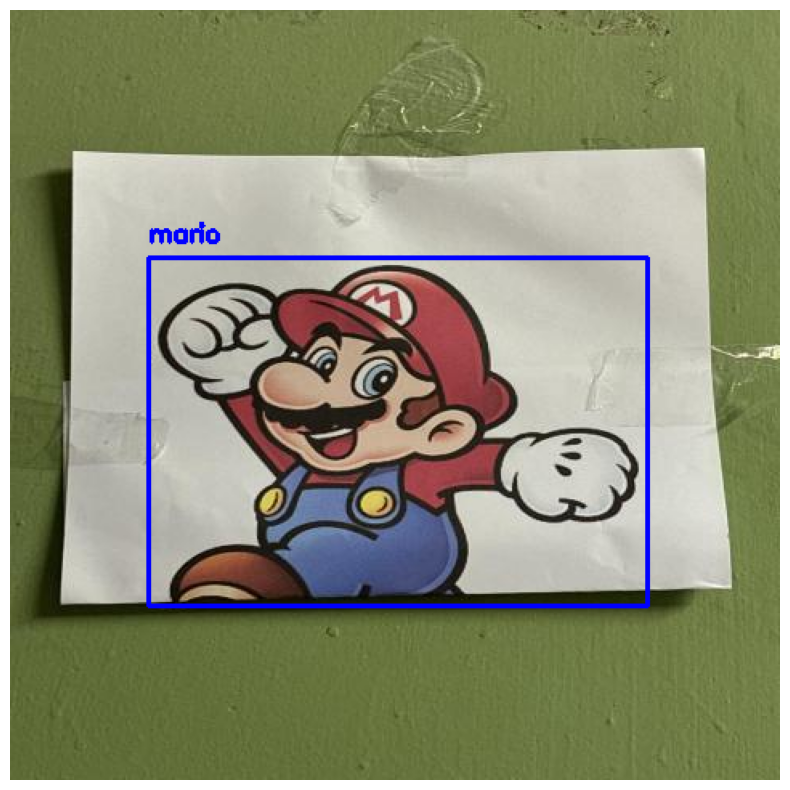

Processed image IMG_1721_jpg.rf.8aff10216bde4bafc3fc03ceb2299459.jpg in 0.4231 seconds

0: 480x480 1 mario, 18.0ms
Speed: 1.3ms preprocess, 18.0ms inference, 1.4ms postprocess per image at shape (1, 3, 480, 480)


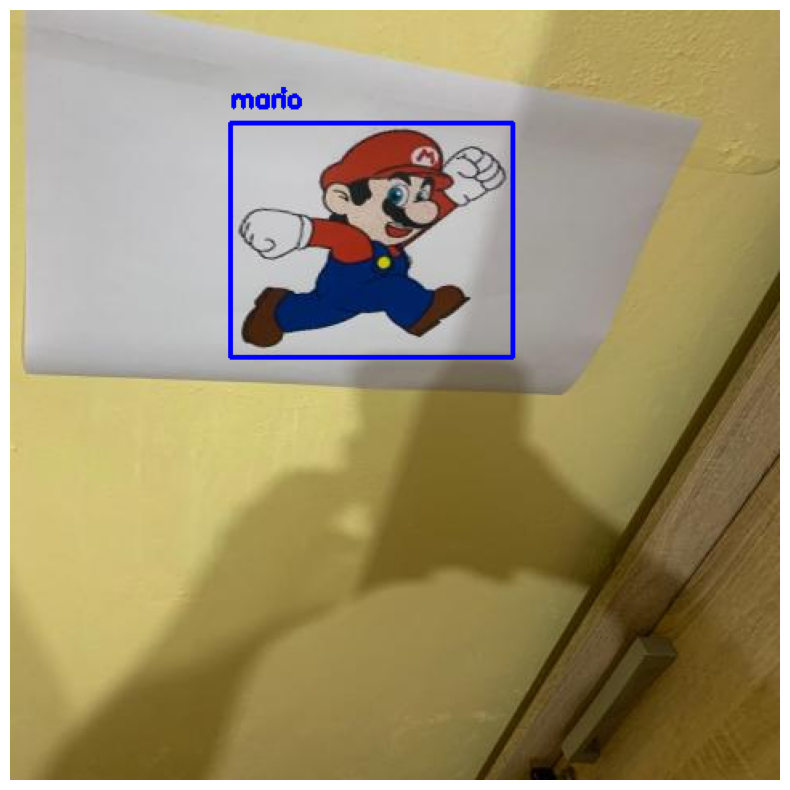

Processed image 9647846e-cced-4c18-b884-436bcdc72306_jpg.rf.5a35b40977690492420ba2fcaab44b05.jpg in 0.3764 seconds
Total time for processing all images: 21.29 seconds
Mean Precision at IoU 0.5: 0.9871
Mean Recall at IoU 0.5: 1.0000
Mean IoU: nan


In [8]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from ultralytics import YOLO
import os
import time
from sklearn.metrics import precision_score, recall_score
from collections import defaultdict

# Load the trained YOLO model
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  # Replace with your trained model path

# Path to test images and labels
image_folder = '/kaggle/working/klangklingklungbabibu-7/test/images'
label_folder = '/kaggle/working/klangklingklungbabibu-7/test/labels'

# Load class names from the model
class_names = model.names  # Class names from the trained model

# Function to draw bounding boxes (only predicted with labels)
def draw_boxes(image, boxes, class_ids, color):
    for i, box in enumerate(boxes):
        x1, y1, x2, y2 = map(int, box)  # Convert to int if needed
        class_id = int(class_ids[i])  # Get the class ID for this box
        class_name = class_names[class_id]  # Get the class name using the class ID
        
        # Draw the bounding box
        cv2.rectangle(image, (x1, y1), (x2, y2), color, 2)
        
        # Label with class name (just the name, no ID)
        label = class_name  # Use only the class name
        
        # Add text (class name) on the image
        cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

# Function to load ground truth boxes from label files (not used for drawing anymore)
def load_ground_truth_labels(label_file, image_shape):
    with open(label_file, 'r') as f:
        labels = f.readlines()
    
    ground_truth_boxes = []
    h, w, _ = image_shape  # Get image height and width
    for label in labels:
        # YOLO format: class_id x_center y_center width height (normalized)
        parts = label.strip().split()
        class_id, x_center, y_center, width, height = map(float, parts)
        
        # Convert normalized coordinates to pixel values
        x_center, y_center, width, height = x_center * w, y_center * h, width * w, height * h
        
        # Convert to [x1, y1, x2, y2] format
        x1 = int(x_center - width / 2)
        y1 = int(y_center - height / 2)
        x2 = int(x_center + width / 2)
        y2 = int(y_center + height / 2)
        
        ground_truth_boxes.append([x1, y1, x2, y2])
    
    return ground_truth_boxes

# Function to compute IoU (Intersection over Union)
def compute_iou(box1, box2):
    x1, y1, x2, y2 = box1
    x1_g, y1_g, x2_g, y2_g = box2
    
    # Calculate intersection area
    inter_x1 = max(x1, x1_g)
    inter_y1 = max(y1, y1_g)
    inter_x2 = min(x2, x2_g)
    inter_y2 = min(y2, y2_g)
    
    inter_area = max(0, inter_x2 - inter_x1) * max(0, inter_y2 - inter_y1)
    
    # Calculate union area
    area1 = (x2 - x1) * (y2 - y1)
    area2 = (x2_g - x1_g) * (y2_g - y1_g)
    union_area = area1 + area2 - inter_area
    
    # IoU Calculation
    return inter_area / union_area if union_area > 0 else 0

# Function to calculate precision and recall
def compute_precision_recall(pred_boxes, gt_boxes, iou_threshold=0.5):
    tp = 0
    fp = 0
    fn = 0
    
    for pred_box in pred_boxes:
        best_iou = 0
        best_gt = None
        for gt_box in gt_boxes:
            iou = compute_iou(pred_box, gt_box)
            if iou > best_iou:
                best_iou = iou
                best_gt = gt_box
        
        if best_iou >= iou_threshold:
            tp += 1
            gt_boxes.remove(best_gt)  # Remove the ground truth box after a match
        else:
            fp += 1
    
    fn = len(gt_boxes)  # Remaining ground truth boxes are false negatives
    
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0
    
    return precision, recall

# Initialize variables for time tracking
total_start_time = time.time()  # Start time for the entire image processing

# To store precision, recall, and IoU for each image
precisions = []
recalls = []
ious = []

# Loop through each test image
for image_name in os.listdir(image_folder):
    image_start_time = time.time()  # Start time for processing the current image

    # Load the image
    image_path = os.path.join(image_folder, image_name)
    image = cv2.imread(image_path)
    
    # Load the corresponding ground truth labels (not used for drawing anymore)
    label_file = os.path.join(label_folder, image_name.replace('.jpg', '.txt'))  # Assuming .jpg images
    ground_truth_boxes = load_ground_truth_labels(label_file, image.shape)
    
    # Make predictions using the YOLO model
    results = model.predict(image)

    # Extract the predicted boxes and class ids
    predicted_boxes = results[0].boxes.xyxy.cpu().numpy()  # Get the predicted boxes (convert to numpy array)
    class_ids = results[0].boxes.cls.cpu().numpy()  # Get the predicted class IDs

    # Calculate precision and recall for this image
    precision, recall = compute_precision_recall(predicted_boxes, ground_truth_boxes, iou_threshold=0.5)
    precisions.append(precision)
    recalls.append(recall)
    
    # Calculate IoU for each predicted box and the corresponding ground truth
    iou_for_image = [compute_iou(pred_box, gt_box) for pred_box in predicted_boxes for gt_box in ground_truth_boxes]
    ious.append(np.mean(iou_for_image))  # Average IoU for this image
    
    # Create a copy of the image to draw on
    image_copy = image.copy()

    # Only draw predicted boxes in blue and label with class names (no class ID)
    draw_boxes(image_copy, predicted_boxes, class_ids, (255, 0, 0))  # Blue color in BGR
    
    # Convert BGR to RGB (OpenCV loads images in BGR by default)
    image_copy_rgb = cv2.cvtColor(image_copy, cv2.COLOR_BGR2RGB)

    # Display the image with predictions using matplotlib
    plt.figure(figsize=(10, 10))
    plt.imshow(image_copy_rgb)
    plt.axis('off')  # Hide axes
    plt.show()

    # Calculate and print the time taken to process this image
    image_elapsed_time = time.time() - image_start_time
    print(f"Processed image {image_name} in {image_elapsed_time:.4f} seconds")

# Calculate total time for processing all images
total_elapsed_time = time.time() - total_start_time
print(f"Total time for processing all images: {total_elapsed_time:.2f} seconds")

# Calculate mean precision and recall for all images
mean_precision = np.mean(precisions)
mean_recall = np.mean(recalls)

# Calculate mAP@50 (Mean Average Precision at IoU threshold 0.5)
mAP50 = mean_precision  # Since you compute precision at 0.5 IoU threshold
print(f"Mean Precision at IoU 0.5: {mean_precision:.4f}")
print(f"Mean Recall at IoU 0.5: {mean_recall:.4f}")

# Calculate mean IoU for all images
mean_iou = np.mean(ious)
print(f"Mean IoU: {mean_iou:.4f}")

In [9]:
import cv2
import numpy as np
from ultralytics import YOLO
import os
import time  # Import time module for counting time

# Load the trained YOLO model
model = YOLO("/kaggle/working/runs/detect/train/weights/best.pt")  # Replace with your trained model path

# Video folder and output folder
input_folder = '/kaggle/working/Test video (open)/'
output_folder = '/kaggle/working/processed_videos/'

# Ensure the output folder exists
os.makedirs(output_folder, exist_ok=True)

# Load class names from the model
class_names = model.names  # Class names from the trained model

# Function to draw bounding boxes based on confidence scores
def draw_boxes(image, boxes, class_ids, confidences):
    if confidences.size == 0:  # Check if the confidences array is empty
        return image  # Return the image without drawing anything if no objects are detected
    
    max_confidence = max(confidences)  # Get the highest confidence in the current frame

    for i, box in enumerate(boxes):
        confidence = confidences[i]  # Get the confidence score for this box
        x1, y1, x2, y2 = map(int, box)  # Convert to int if needed
        class_id = int(class_ids[i])  # Get the class ID for this box
        class_name = class_names[class_id]  # Get the class name using the class ID
        
        # Draw the bounding box depending on the conditions
        if confidence > 0.7:
            # Draw a green box for objects with confidence > 0.5
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 255, 0), 2)  # Green color
            label = f"{class_name} ({confidence:.2f})"
            cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)
        elif confidence <= 0.7 and max_confidence > 0.7:
            # Draw a red box if confidence <= 0.7 but there's an object with confidence > 0.7
            cv2.rectangle(image, (x1, y1), (x2, y2), (0, 0, 255), 2)  # Red color
            label = f"{class_name} ({confidence:.2f})"
            cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
        else:
            # Draw a blue box if confidence <= 0.7 and no object has confidence > 0.7
            cv2.rectangle(image, (x1, y1), (x2, y2), (255, 0, 0), 2)  # Blue color
            label = f"{class_name} ({confidence:.2f})"
            cv2.putText(image, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 2)

    return image

# Open the text file to log results
log_file_path = '/kaggle/working/processing_log.txt'
with open(log_file_path, 'w') as log_file:
    # Write a header to the log file
    log_file.write("Processing Log for Video Frames\n")
    log_file.write("="*50 + "\n")

    # Process each video from OTV1.mp4 to OTV5.mp4
    for i in range(1, 6):
        # Construct input and output paths for each video
        input_video_path = os.path.join(input_folder, f"OTV{i}.mp4")
        output_video_path = os.path.join(output_folder, f"processed_OTV{i}.mp4")

        # Open the video
        cap = cv2.VideoCapture(input_video_path)

        # Get the video frame rate and size
        fps = int(cap.get(cv2.CAP_PROP_FPS))  # Frames per second
        frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
        frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

        # Define the codec and create VideoWriter object to save the processed video
        fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # You can change this to 'XVID' or others depending on your system
        out = cv2.VideoWriter(output_video_path, fourcc, fps, (frame_width, frame_height))

        # Track the total processing time for the video
        start_video_time = time.time()  # Start time for the entire video

        # Process each frame in the video
        frame_count = 0  # To count number of frames processed
        while cap.isOpened():
            ret, frame = cap.read()  # Read a frame from the video
            if not ret:
                break  # Exit if there are no frames left

            # Start time for processing this frame
            start_frame_time = time.time()

            # Make predictions using the YOLO model
            results = model.predict(frame)

            # Extract the predicted boxes, class ids, and confidence scores
            predicted_boxes = results[0].boxes.xyxy.cpu().numpy()  # Get the predicted boxes (convert to numpy array)
            class_ids = results[0].boxes.cls.cpu().numpy()  # Get the predicted class IDs
            confidences = results[0].boxes.conf.cpu().numpy()  # Get the predicted confidence scores

            # Create a copy of the frame to draw on
            frame_copy = frame.copy()

            # Draw boxes with different colors based on the confidence scores
            frame_copy = draw_boxes(frame_copy, predicted_boxes, class_ids, confidences)

            # Write the processed frame to the output video
            out.write(frame_copy)

            # Calculate and print the time taken to process this frame
            frame_elapsed_time = time.time() - start_frame_time
            frame_count += 1  # Increment the frame count

            # Log and print frame processing time
            frame_log = f"Processed frame {frame_count} in {frame_elapsed_time:.4f} seconds"
            print(frame_log)  # Print to console
            log_file.write(frame_log + "\n")  # Write to log file

        # Release the video capture and writer objects for the current video
        cap.release()
        out.release()

        # Calculate and print the total time taken for the entire video
        total_video_time = time.time() - start_video_time
        video_log = f"Total time to process video OTV{i}: {total_video_time:.2f} seconds\n"
        print(video_log)  # Print to console
        log_file.write(video_log)  # Write to log file

        log_file.write(f"Total frames processed in video OTV{i}: {frame_count}\n")
        log_file.write("="*50 + "\n")

    print("Processing complete for all videos (OTV1 to OTV5).")
    log_file.write("Processing complete for all videos (OTV1 to OTV5).\n")

# The processing log will now be saved in 'processing_log.txt' in the specified folder


0: 480x480 1 mario, 18.1ms
Speed: 2.0ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)
Processed frame 1 in 0.4629 seconds

0: 480x480 1 mario, 18.1ms
Speed: 2.1ms preprocess, 18.1ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)
Processed frame 2 in 0.0401 seconds

0: 480x480 1 mario, 18.2ms
Speed: 3.1ms preprocess, 18.2ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)
Processed frame 3 in 0.0418 seconds

0: 480x480 1 mario, 16.5ms
Speed: 2.7ms preprocess, 16.5ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)
Processed frame 4 in 0.0410 seconds

0: 480x480 1 mario, 17.9ms
Speed: 3.2ms preprocess, 17.9ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 480)
Processed frame 5 in 0.0407 seconds

0: 480x480 1 mario, 17.4ms
Speed: 3.2ms preprocess, 17.4ms inference, 1.3ms postprocess per image at shape (1, 3, 480, 480)
Processed frame 6 in 0.0405 seconds

0: 480x480 1 mario, 16.4ms
Speed: